In [1]:
from IPython.display import HTML

HTML('''<script>
code_show=true; 
function code_toggle() {
 if (code_show){
 $('div.input').hide();
 } else {
 $('div.input').show();
 }
 code_show = !code_show
} 
$( document ).ready(code_toggle);
</script>
<form action="javascript:code_toggle()"><input type="submit" value="Click here to toggle on/off the raw code."></form>''')

In [1]:
from plot_graph import *

%matplotlib notebook
# %config InlineBackend.figure_format='retina'

from mpl_toolkits.mplot3d import Axes3D

/home/ayl081/.local/lib/python3.7/site-packages/uproot3/__init__.py:138: FutureWarning: Consider switching from 'uproot3' to 'uproot', since the new interface became the default in 2020.

    pip install -U uproot

In Python:

    >>> import uproot
    >>> with uproot.open(...) as file:
    ...

  FutureWarning
/home/ayl081/.local/lib/python3.7/site-packages/awkward0/__init__.py:23: FutureWarning: Consider switching from 'awkward0' to 'awkward', since the new interface became the default in 2020.

    pip install -U awkward

In Python:

    >>> import awkward as ak
    >>> new_style_array = ak.from_awkward0(old_style_array)
    >>> old_style_array = ak.to_awkward0(new_style_array)

  FutureWarning


In [2]:
# obtain first batch of graphs
batch=graph_dataset[0]

print(f"first batch of graph dataset contains {len(batch)} jet graphs")

first batch of graph dataset contains 941 jet graphs


In [3]:
# get a smaller subset of the first batch for visualization

k=10
batch_small=batch[:k]
print(f"use first {k} jet graphs for visualization")


# initalize for plotting
activation=nn.Softmax(1)
eta_idx,phi_idx=graph_dataset.features.index("track_etarel"),graph_dataset.features.index("track_phirel")


use first 10 jet graphs for visualization


## GNNExplainer

In [4]:
from graph_explainer import *

In [14]:
g = batch_small[1]
# g.batch=torch.tensor(np.zeros(g.x.shape[0]).astype("int64"))
# g.to(device)
model.eval()
log_logits, h = model(g.x, g.edge_index)

In [18]:
h[2]

tensor([-1.1919e+00, -6.3623e+00,  5.3638e+00,  7.2300e+00, -6.7187e+00,
         2.9647e+00, -4.5501e-01, -2.1795e+00,  4.6205e+00,  5.1602e+00,
        -4.7414e-01, -3.4432e+00, -7.3647e-01,  1.1718e+01,  7.9821e+00,
         2.2414e-01, -1.3216e+01,  7.6796e+00,  9.8665e+00,  1.7703e+01,
         5.1847e-01,  1.0024e+01, -3.3028e+00,  1.6099e+01, -1.0966e+01,
         6.3794e-01, -3.3046e+00,  1.3540e+00, -6.9338e-01,  4.4992e+00,
        -7.4414e+00,  9.8919e-01, -2.5040e+00, -7.7958e+00,  4.3308e+00,
         1.2325e+01,  8.1744e+00,  1.2282e+01, -2.6421e+00,  4.8244e+00,
        -7.6050e+00, -1.0283e+01,  6.3789e+00,  1.1654e+01,  3.8106e+00,
        -3.7936e+00, -3.2541e+00,  1.3408e+01, -1.4566e+01, -1.2464e+01,
        -7.9469e+00, -9.3059e+00,  6.4046e+00, -4.4660e+00, -1.1497e+01,
         7.5840e+00,  3.2622e+00, -4.4112e+00,  6.6436e+00,  5.8924e-01,
         6.7453e+00, -2.2779e+01,  1.5934e+00,  1.0931e+01,  6.6997e+00,
        -3.8561e+00,  9.3264e+00, -1.7839e+00, -1.3

In [7]:
explainer = GNNExplainer(model, epochs = 200)

In [8]:
edge_mask, epoch_losses = explainer.explain_graph(g.x, g.edge_index)

tensor([[0.9892, 0.0108]])


ValueError: too many values to unpack (expected 2)

In [17]:
g.edge_index.size()

torch.Size([2, 240])

In [18]:
edge_mask.size()

torch.Size([240])

In [20]:
edge_mask

tensor([0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840,
        0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840,
        0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840,
        0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840,
        0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840,
        0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840,
        0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840,
        0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840,
        0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840,
        0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840,
        0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840,
        0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840, 0.0840,
        0.0840, 0.0840, 0.0840, 0.0840, 

In [19]:
ax, G = explainer.visualize_subgraph(node_idx=3, edge_mask=edge_mask, edge_index=g.edge_index, y=g.y)
plt.show()


ValueError: too many values to unpack (expected 3)

## Plotting

In [12]:
def plot_graph(g,hbb_only=False):
    
    if hbb_only and g.y[0,0]>0:
        return
    
    fig, ax =plt.subplots(figsize=(12,10))
    
    g.batch=torch.tensor(np.zeros(g.x.shape[0]).astype("int64"))
    g.to(device)
    
    model.eval()
    with torch.no_grad():
        u,edge_attr=model(g.x, g.edge_index, g.batch)

    edge_attr=edge_attr.detach().cpu()
#     weight=edge_attr.mean(1)
    weight=np.linalg.norm(edge_attr,ord=2,axis=1)

    g.weight=weight

    G = to_networkx(g, edge_attrs=['weight'])

    edges,weights = zip(*nx.get_edge_attributes(G,'weight').items())
    weights=np.array(weights)

    pos=np.array(list(zip(g.x[:,eta_idx].cpu().numpy(),g.x[:,phi_idx].cpu().numpy())))

    
    
    nodes = nx.draw_networkx_nodes(G,pos,node_color='k',edgecolors="orange",alpha=0.5, with_labels=False,node_size=g.x[:,0].detach().cpu())
    edges = nx.draw_networkx_edges(G,pos,edge_color=weights,width=1,
                                   edge_cmap=plt.cm.gray_r, arrows=True,alpha=0.5,)#edge_vmin=0,edge_vmax=750)
#                                    edge_cmap=plt.cm.bwr, arrows=True,alpha=0.8)#,edge_vmin=-0.1,edge_vmax=0.15)

    
    sm = plt.cm.ScalarMappable(cmap=plt.cm.gray_r, norm=plt.Normalize(vmin=weights.min(), vmax=weights.max()))
#     sm = plt.cm.ScalarMappable(cmap=plt.cm.bwr, norm=plt.Normalize(vmin=-0.1, vmax=0.15))
#     sm = plt.cm.ScalarMappable(cmap=plt.cm.gray_r, norm=plt.Normalize(vmin=0, vmax=750))
    sm.set_array([])
    cbar = plt.colorbar(sm)
    
    plt.axis([-1,1,-1,1])
    

    ax.xaxis.set_major_locator(MultipleLocator(1/10))
    ax.yaxis.set_major_locator(MultipleLocator(1/10))
    
    ax.grid(which='major', color='#CCCCCC', linestyle='--')

    plt.grid(True)
    plt.xlabel("track_etarel")
    plt.ylabel("track_phirel")
    plt.title(f"jet label: {g.y.detach().cpu()}, prob: {activation(u.detach().cpu())}")
    plt.show()
    
    return weights

### graphs for the first 10 jets

jet label: $[1,0] \rightarrow\text{QCD}$, $[0,1]\rightarrow\text{H}\rightarrow\bar{\text{b}}\text{b}$ 

prob: global feature `u` after applying softmax

node size: `track_pt`

node coordiates: (`track_etarel`,`track_phirel`) from the input graph features `x`

<IPython.core.display.Javascript object>


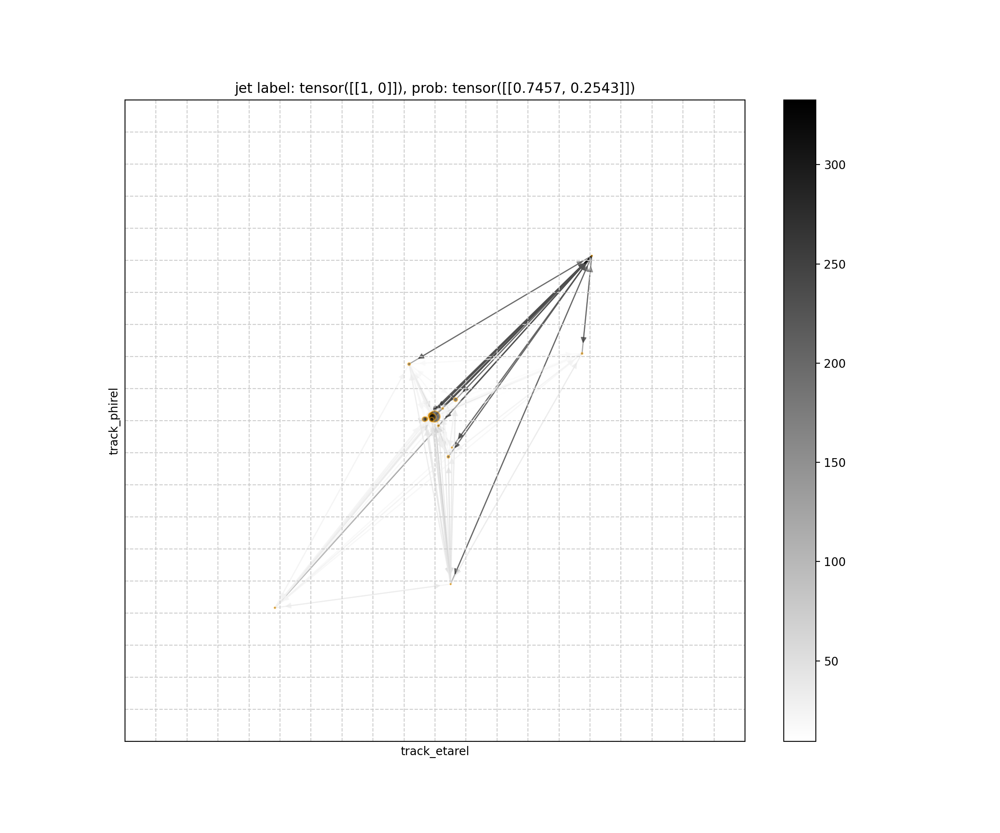

<IPython.core.display.Javascript object>


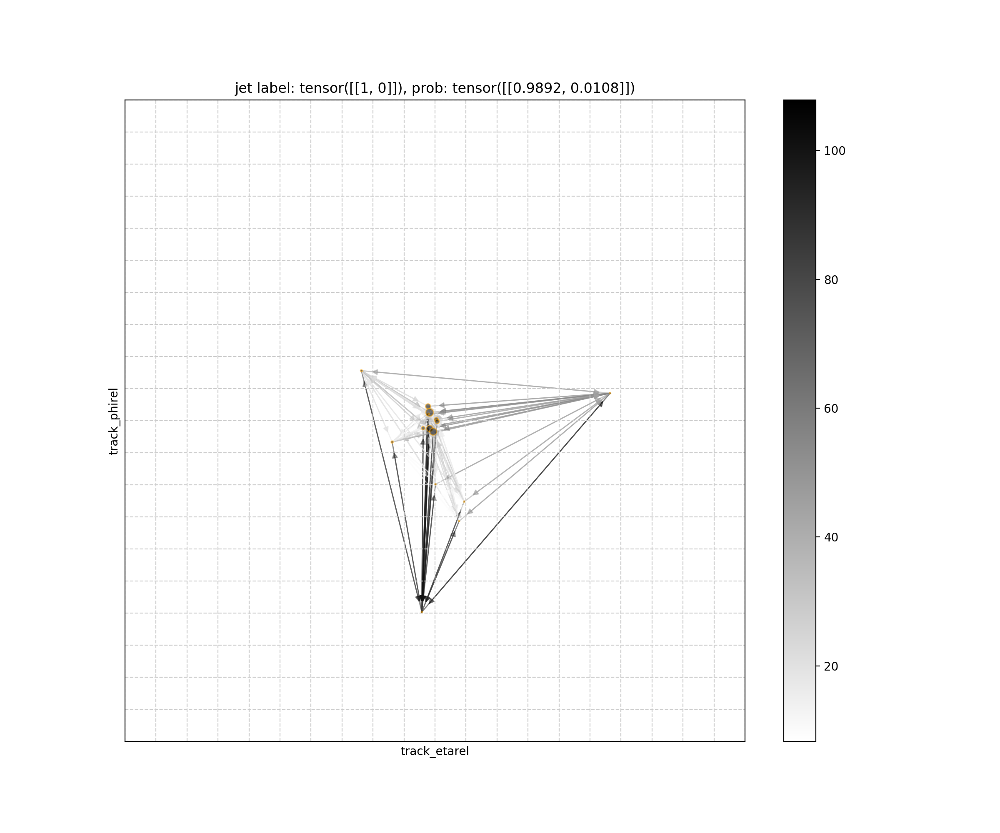

<IPython.core.display.Javascript object>


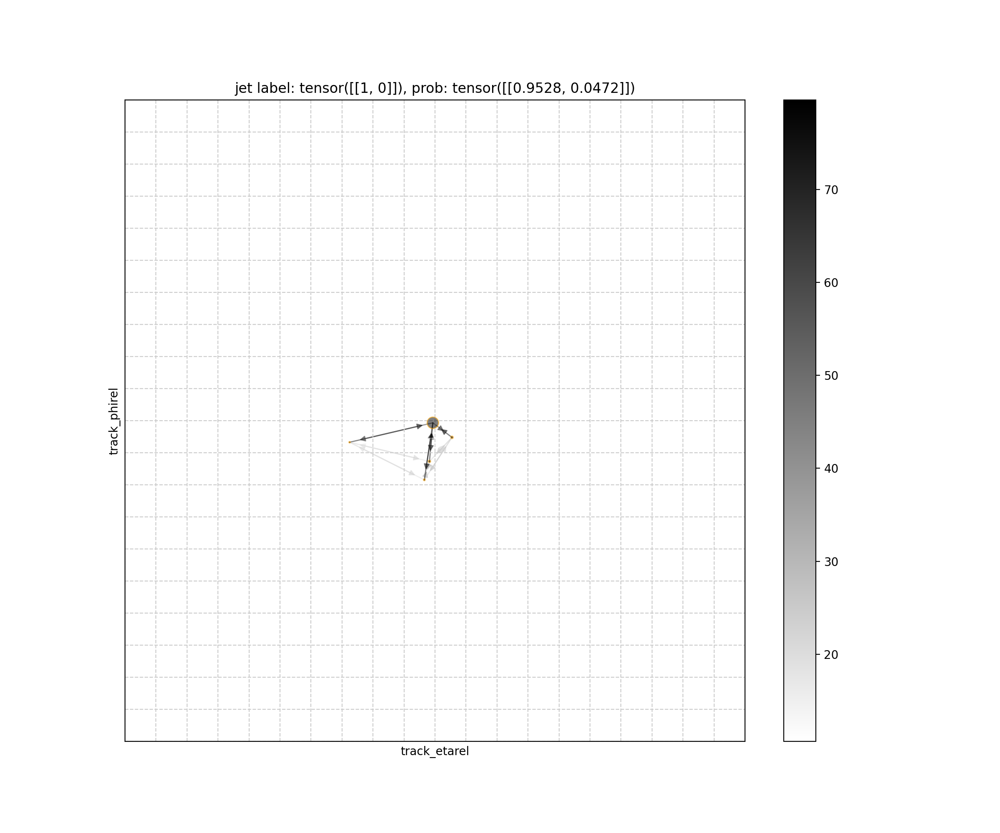

<IPython.core.display.Javascript object>


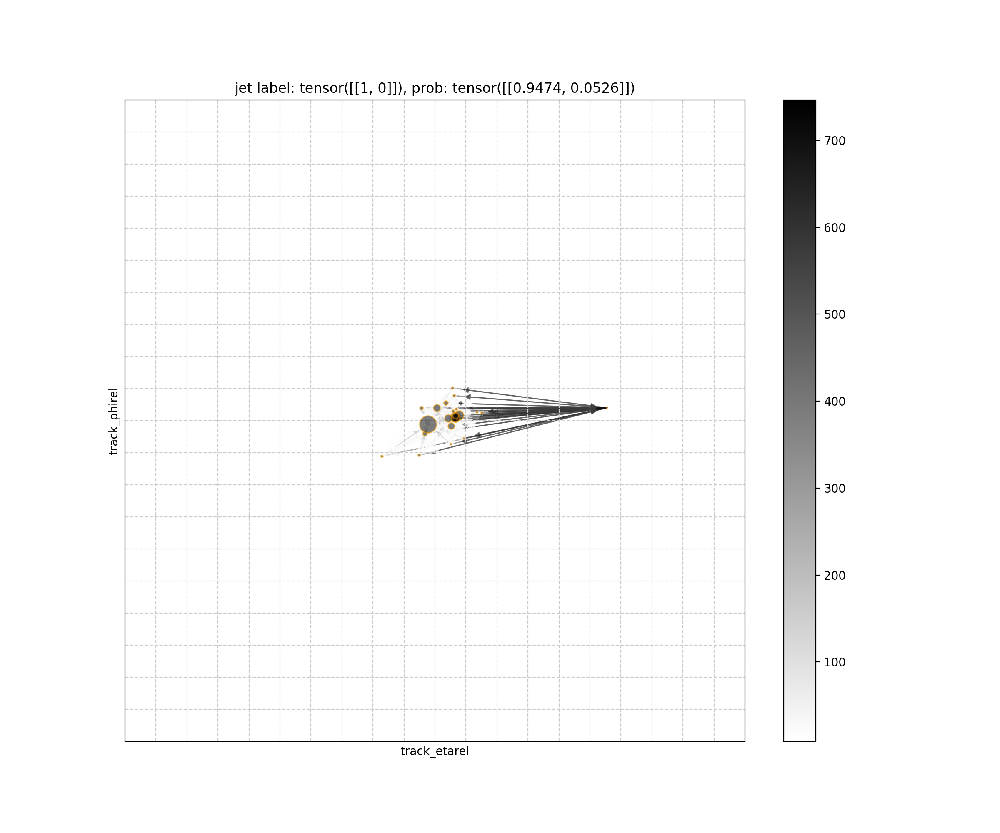

<IPython.core.display.Javascript object>


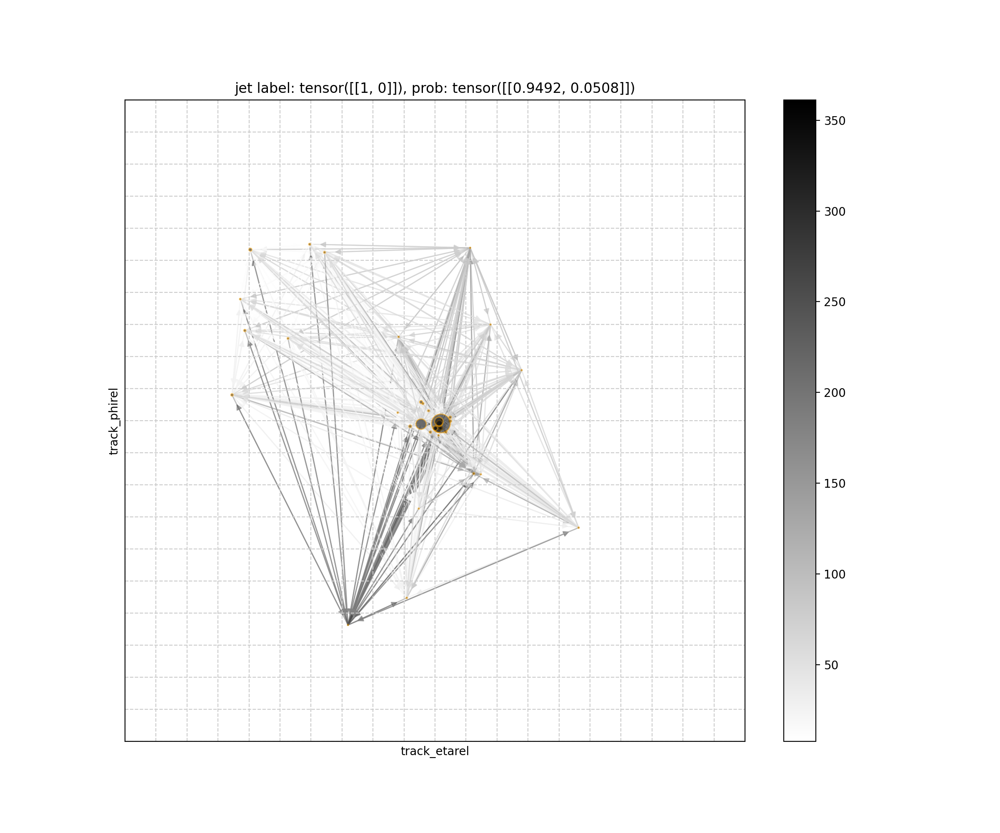

<IPython.core.display.Javascript object>


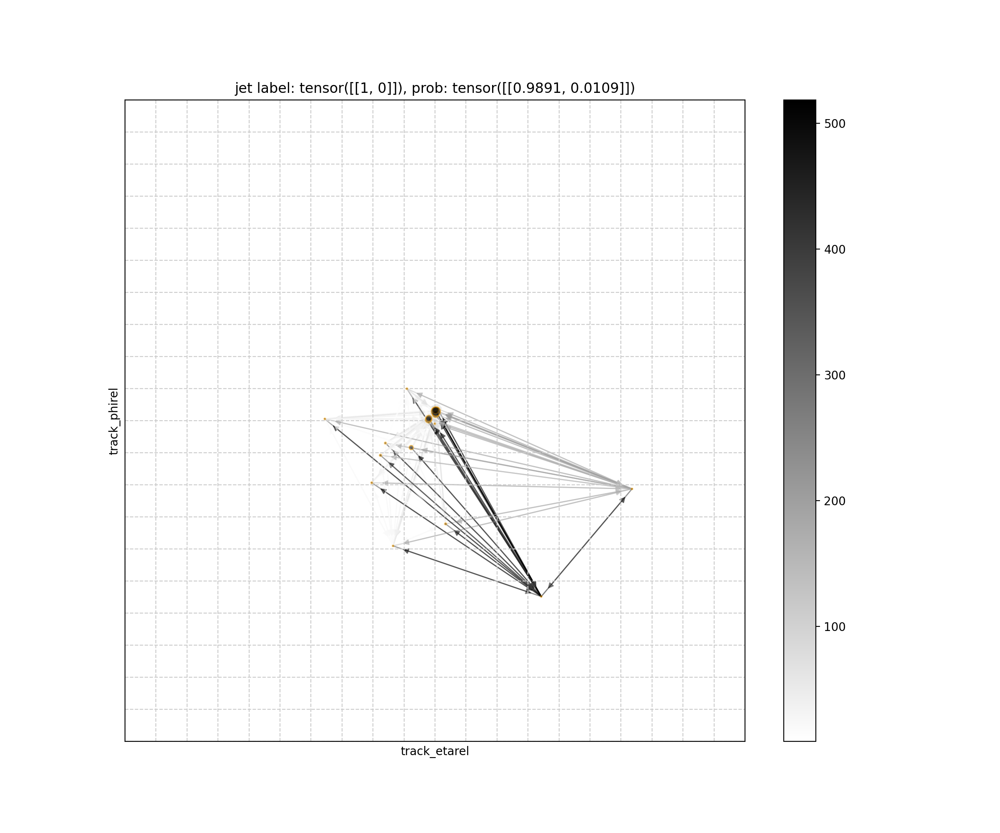

<IPython.core.display.Javascript object>


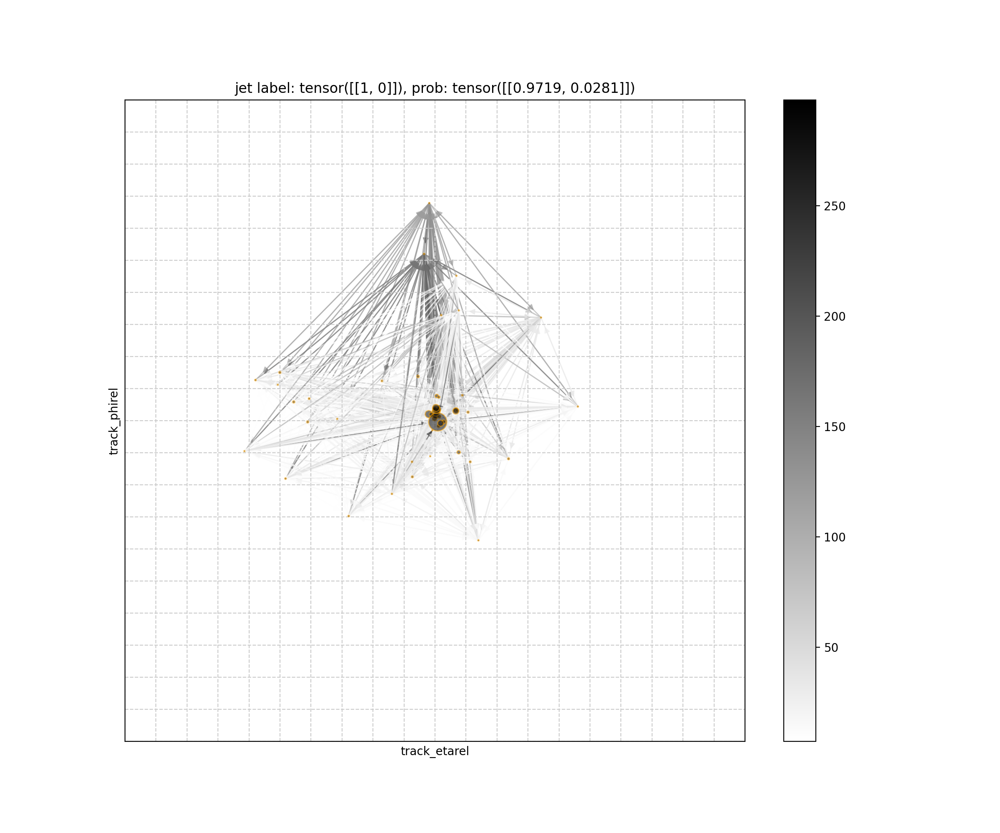

<IPython.core.display.Javascript object>


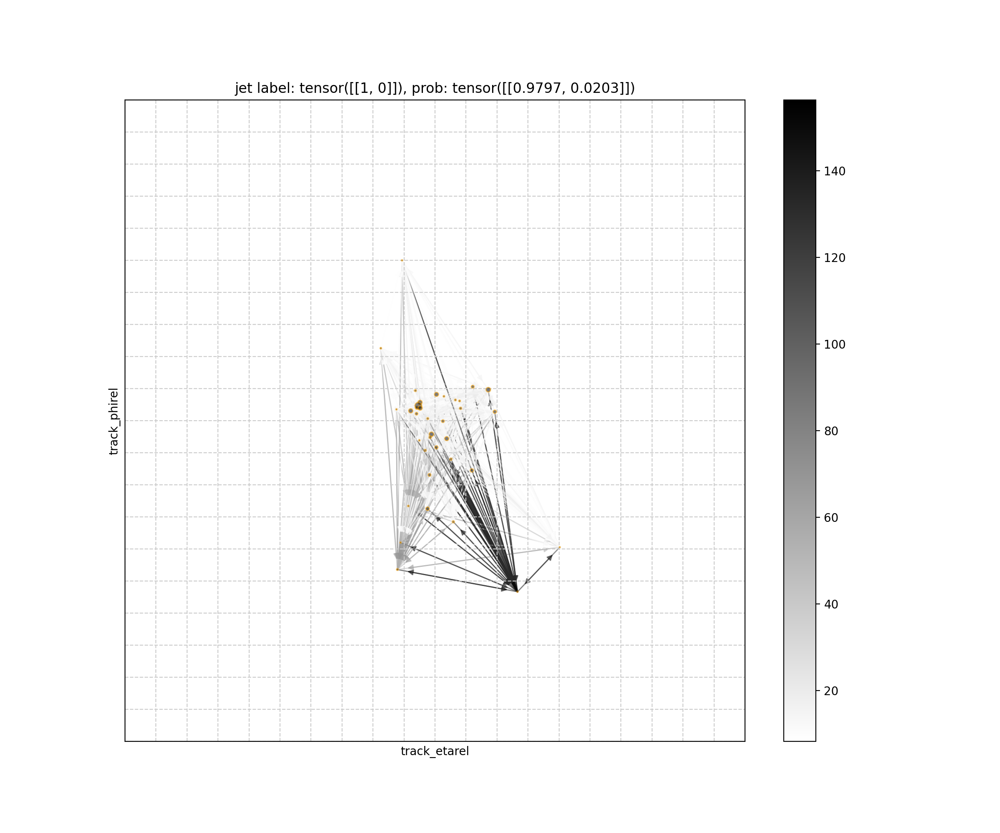

<IPython.core.display.Javascript object>


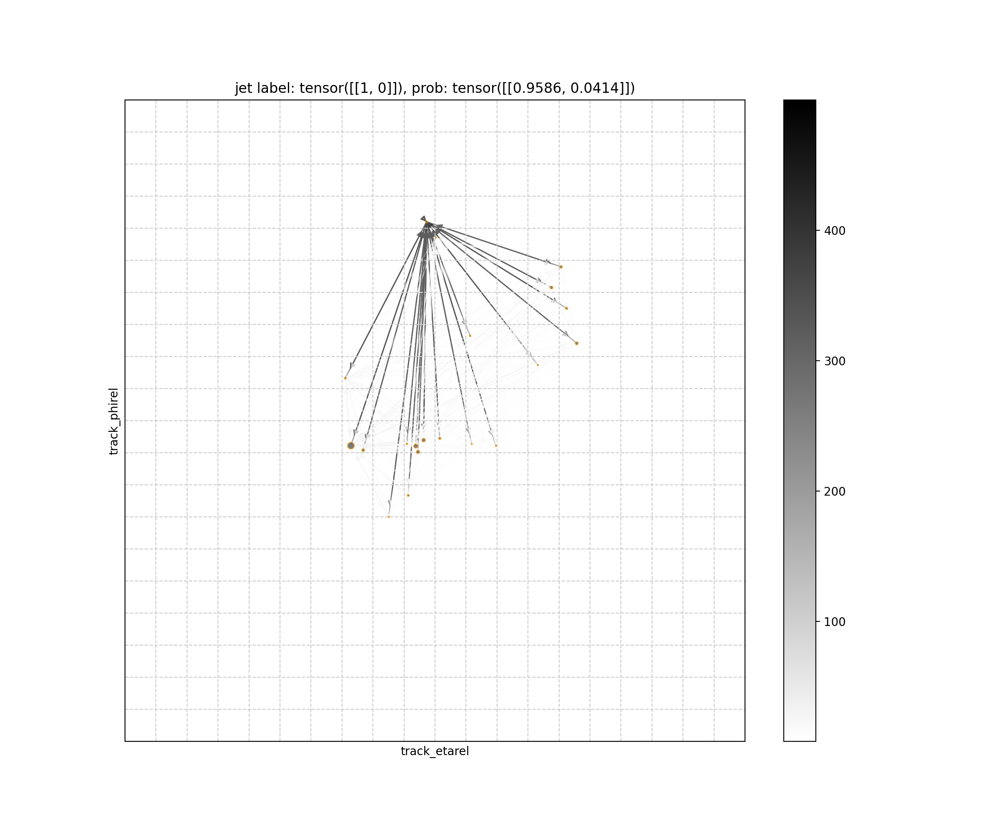

<IPython.core.display.Javascript object>


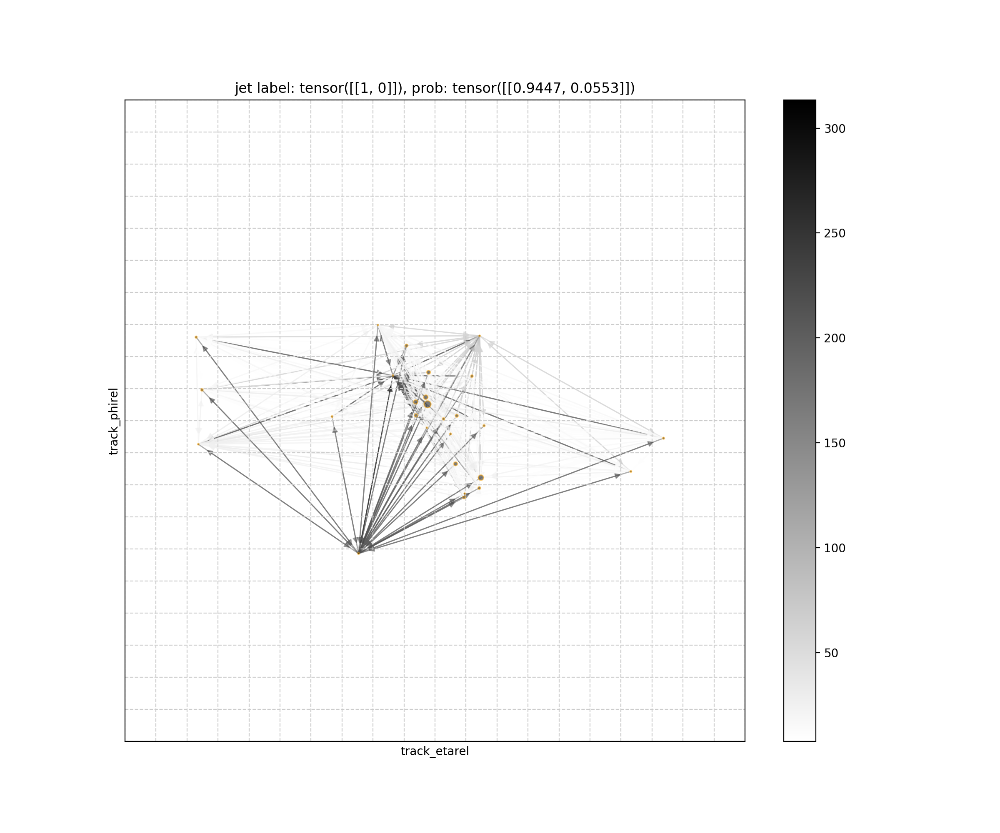

In [12]:
weights=[]
for g in batch_small:
    weights.append(plot_graph(g,False))

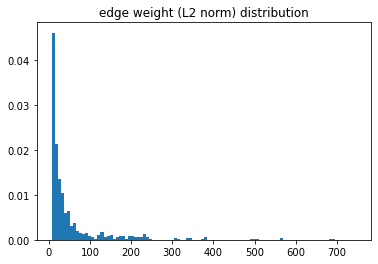

In [12]:
plt.hist(np.hstack(weights),density=True,bins=100)
plt.title("edge weight (L2 norm) distribution")
plt.show()

### the first 30 Higgs jets

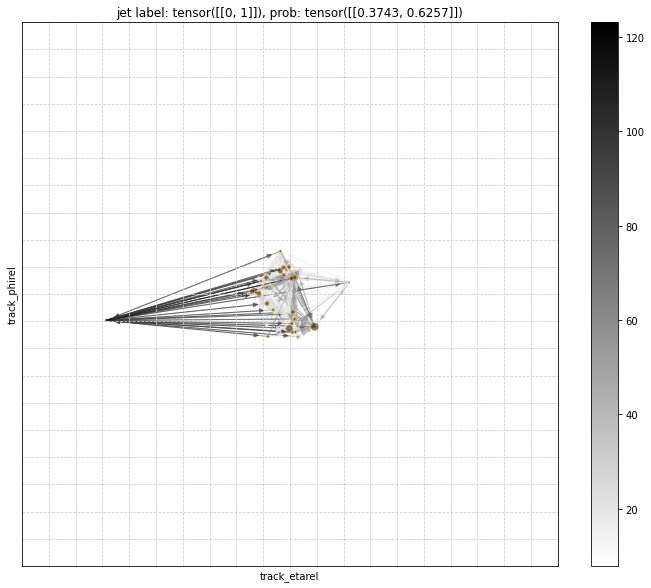

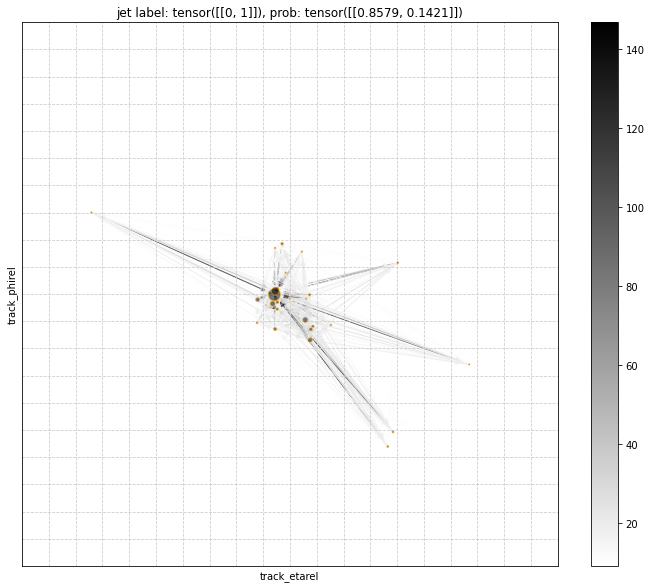

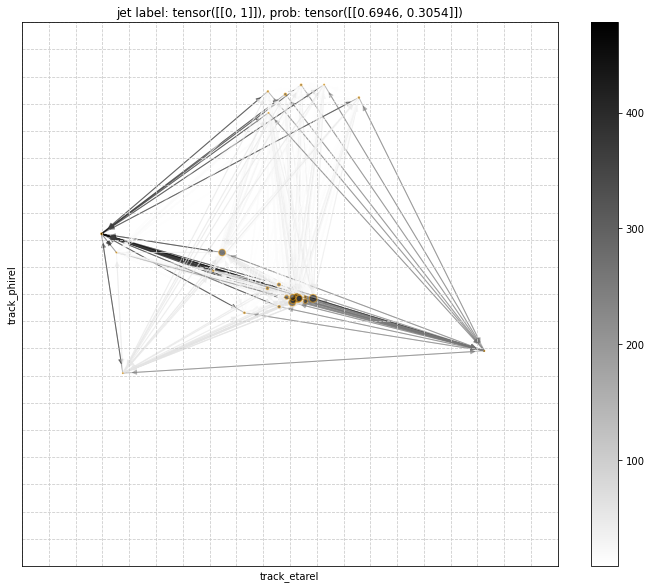

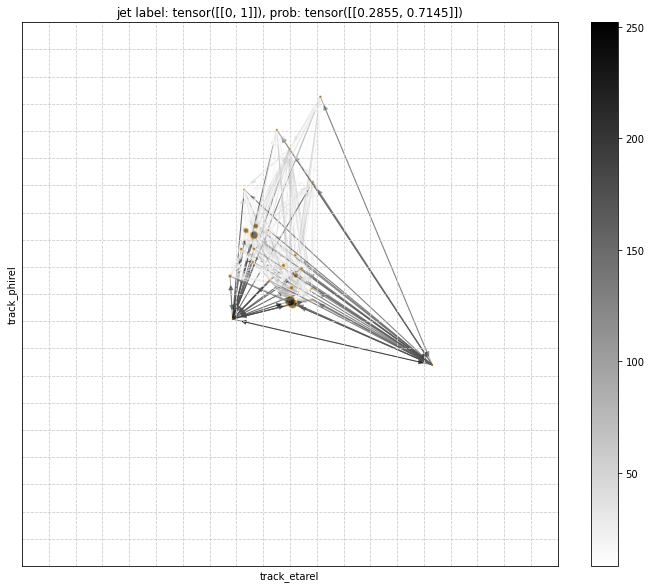

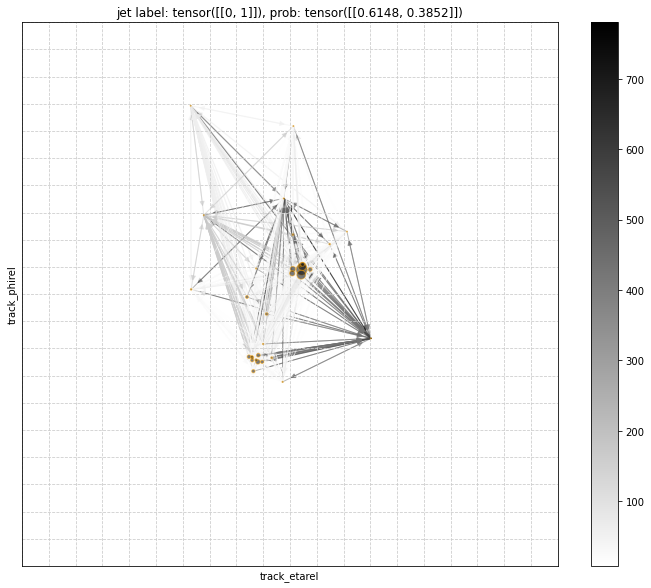

...

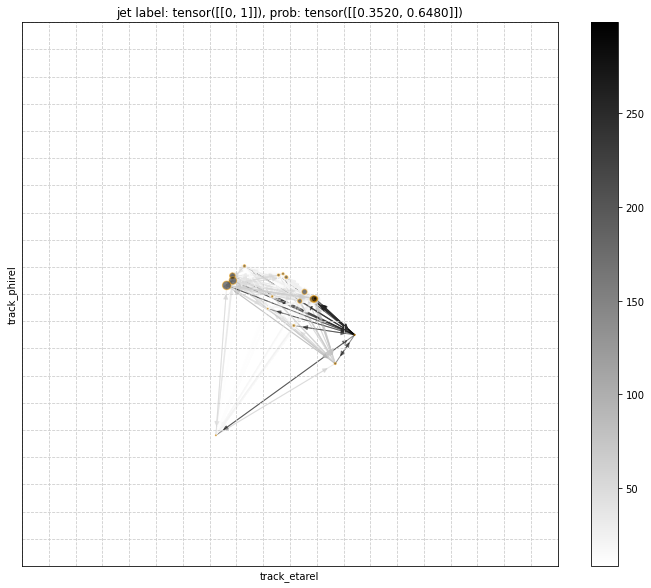

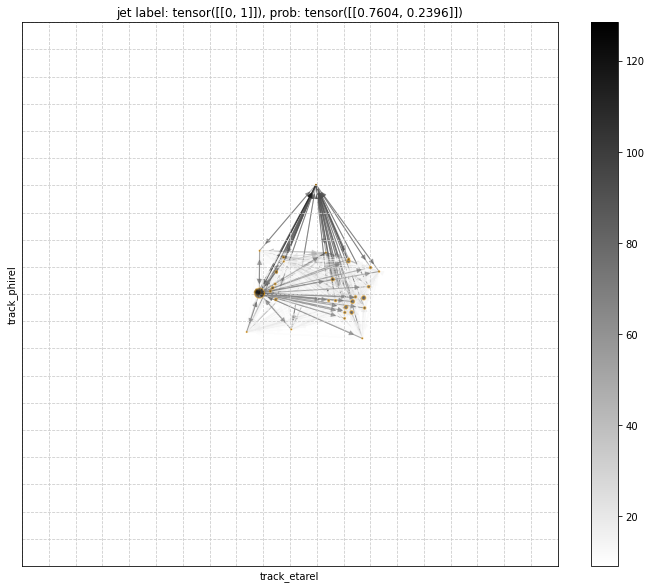

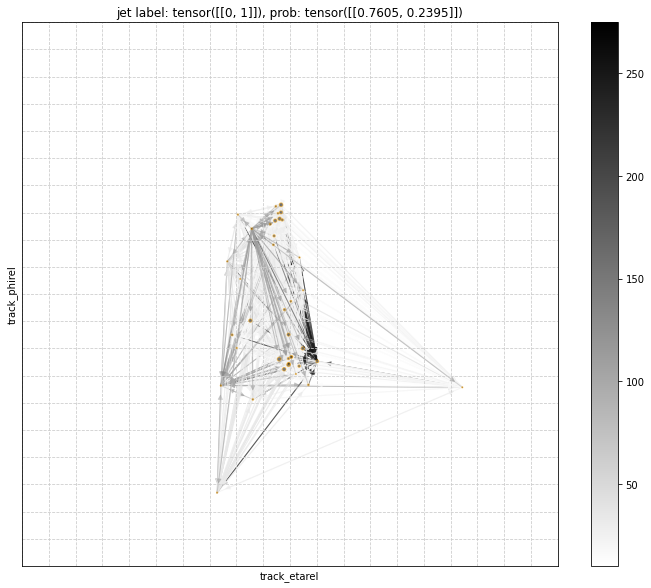

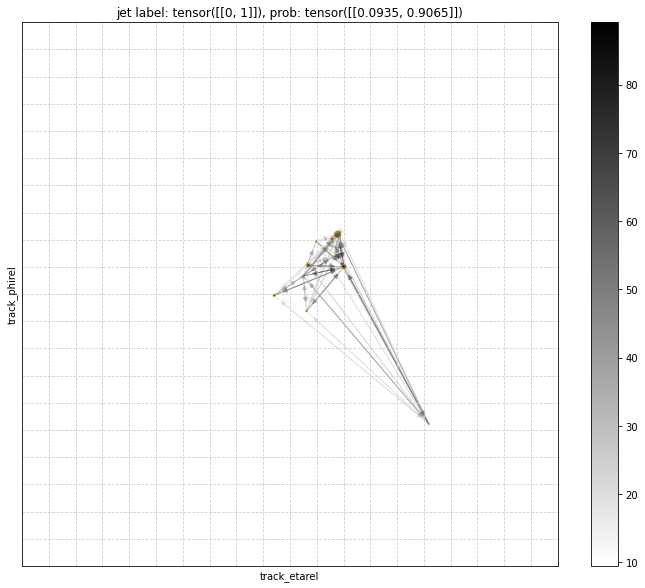

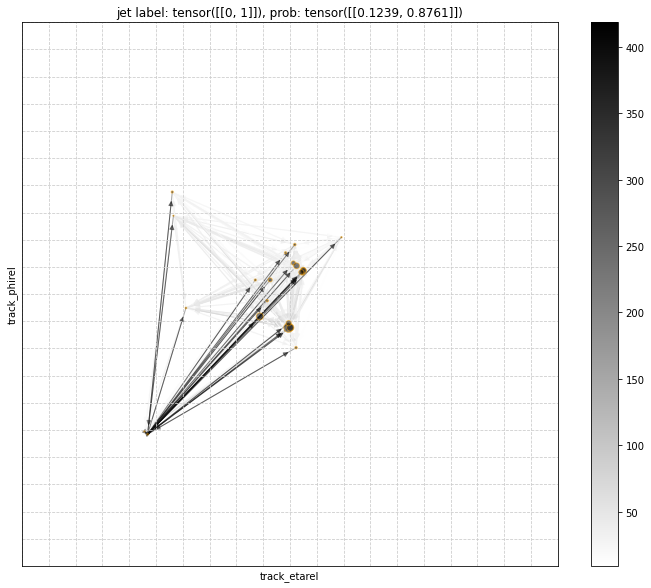

In [13]:
cnt=0
for g in batch:
    if cnt>=30: break
        
    if g.y[0,1]>0:
        _=plot_graph(g,True)
        cnt+=1
    else:
        continue

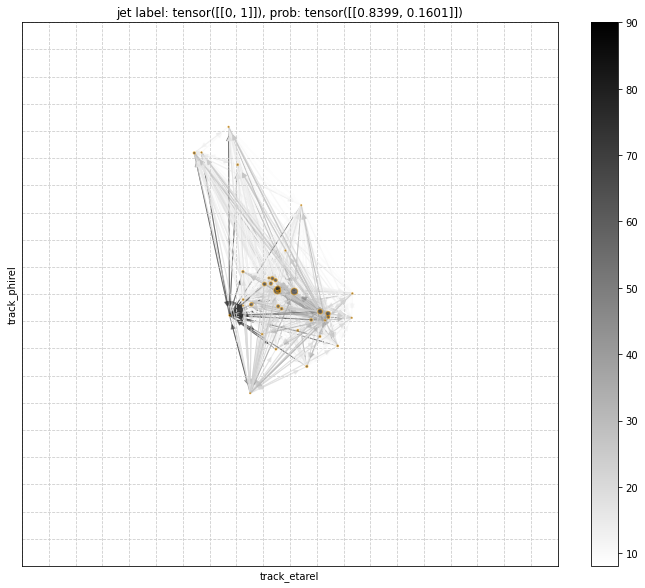

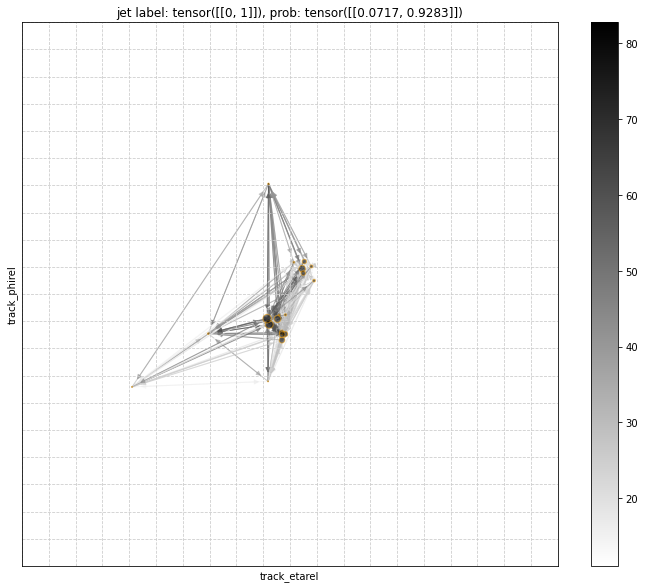

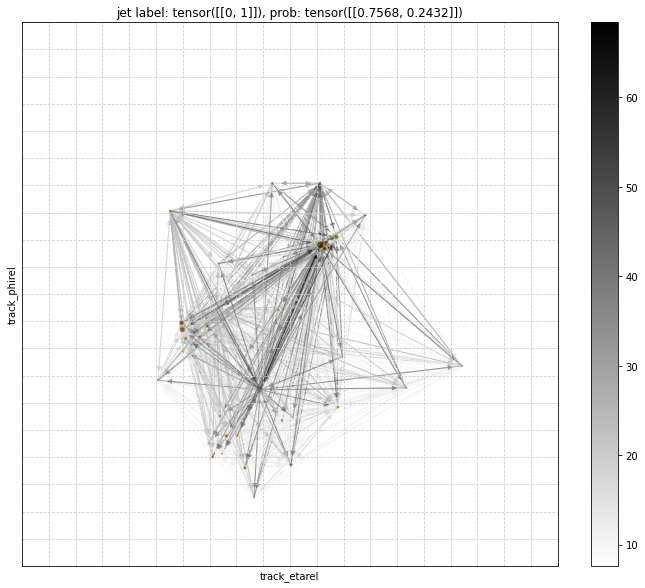

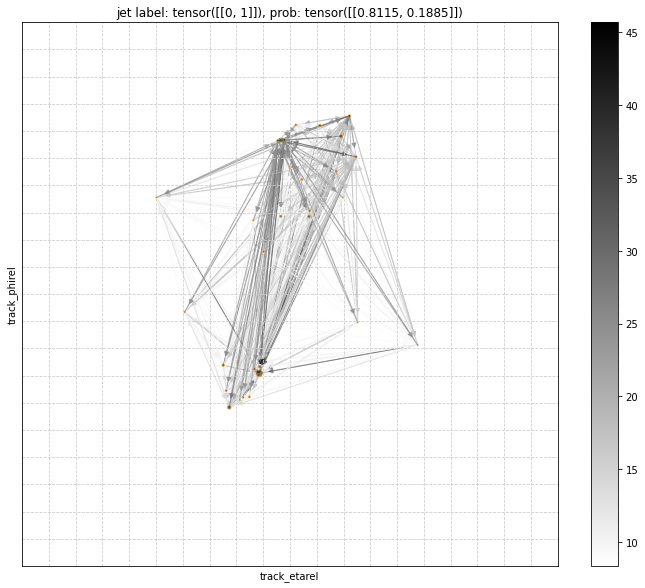

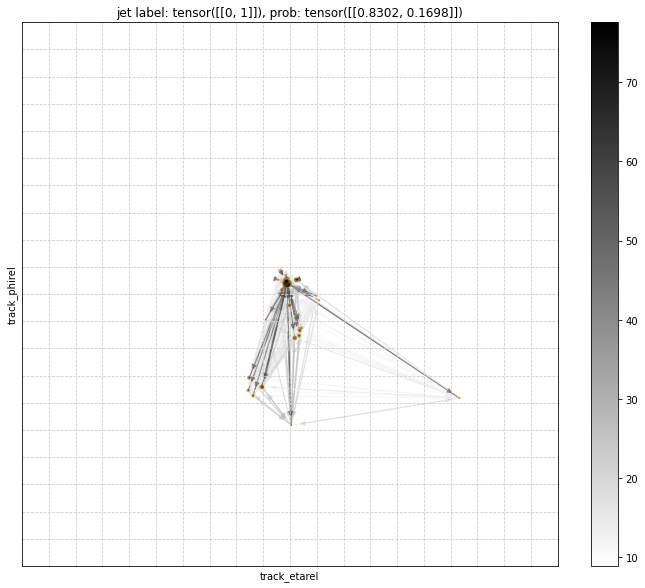

...

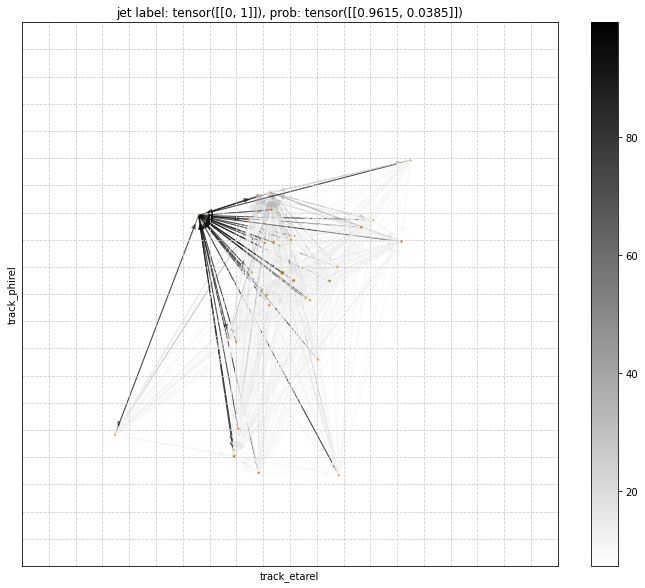

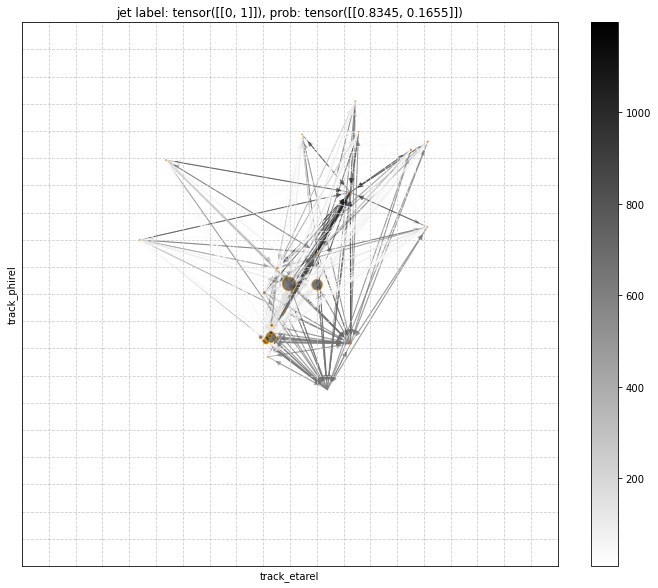

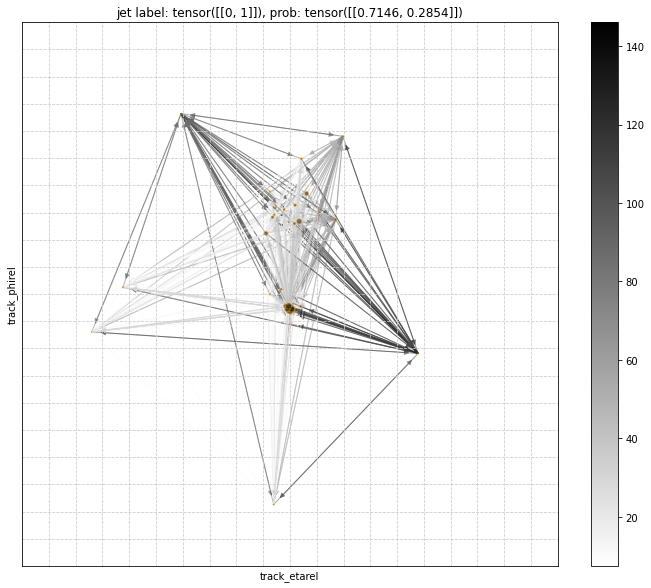

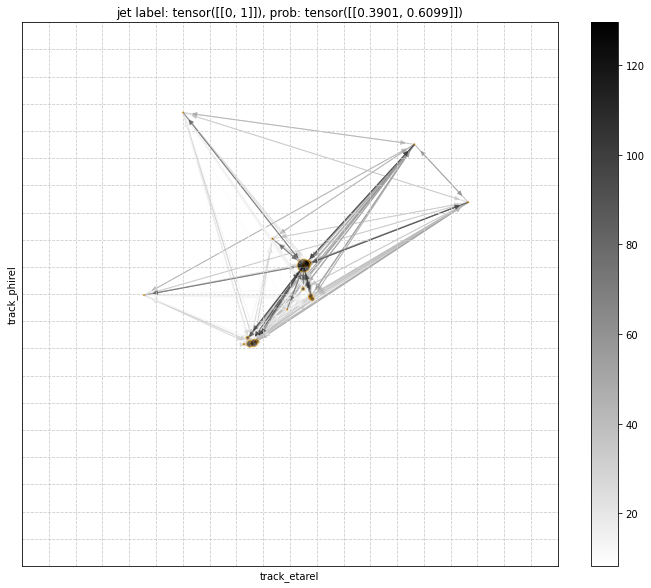

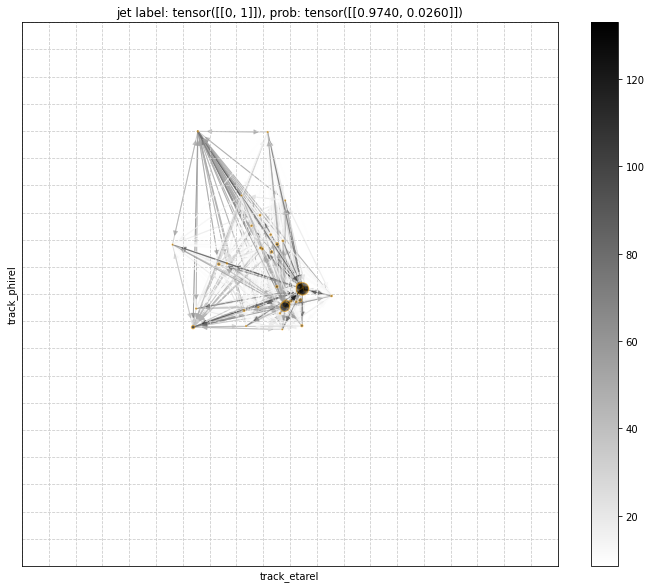

In [14]:
cnt=0
for g in batch[100:]:
    if cnt>=30: break
        
    if g.y[0,1]>0:
        _=plot_graph(g,True)
        cnt+=1
    else:
        continue

### the first 30 QCD jets

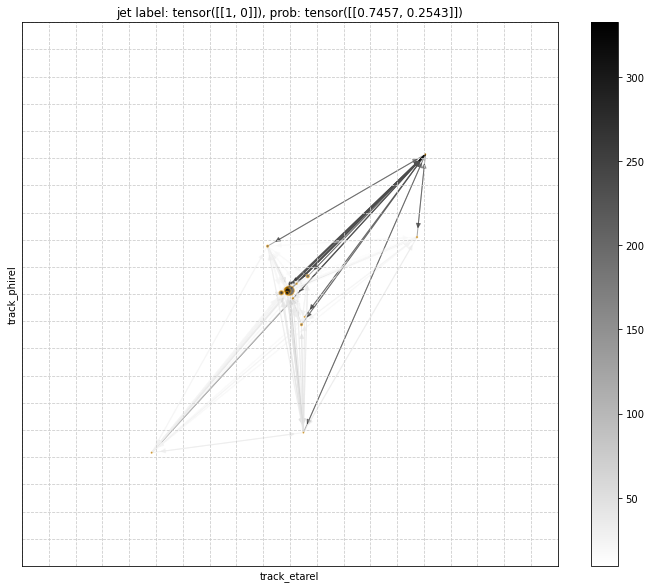

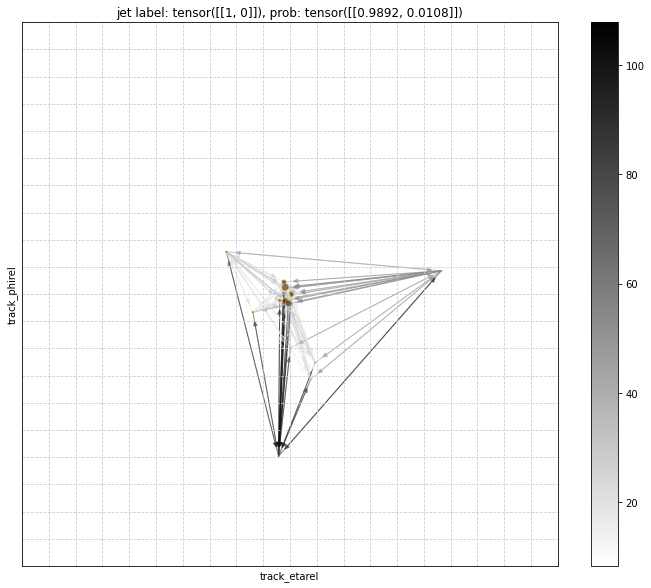

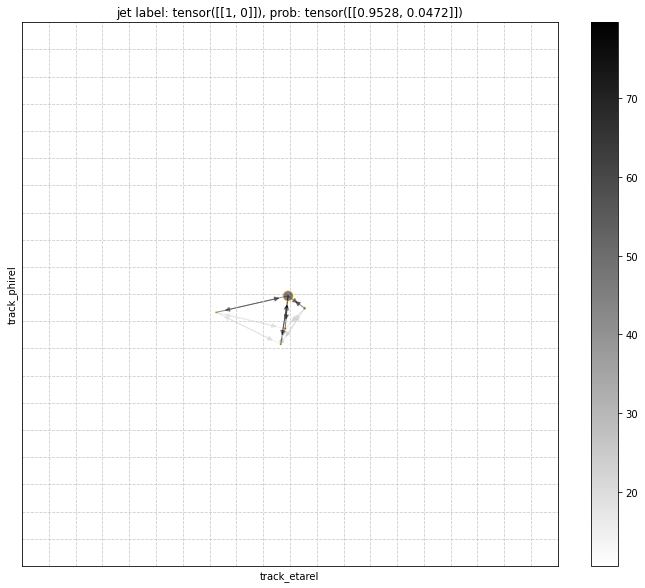

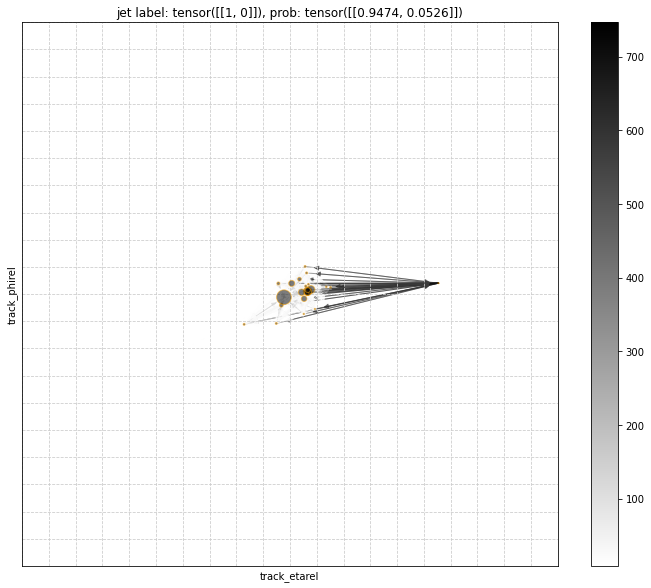

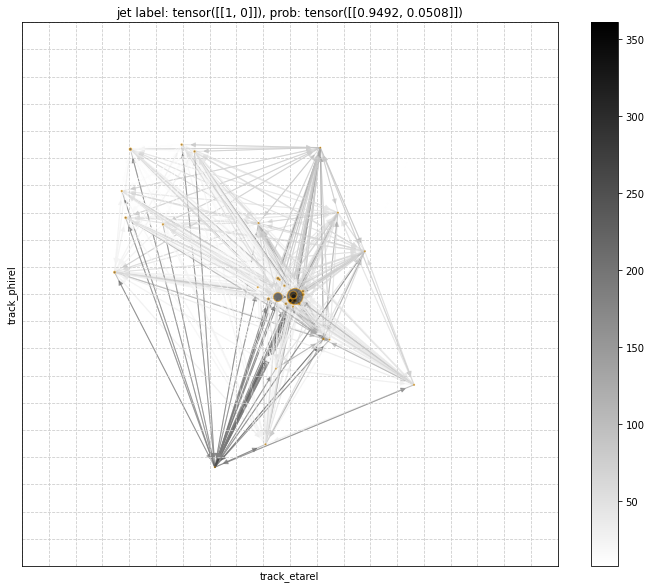

...

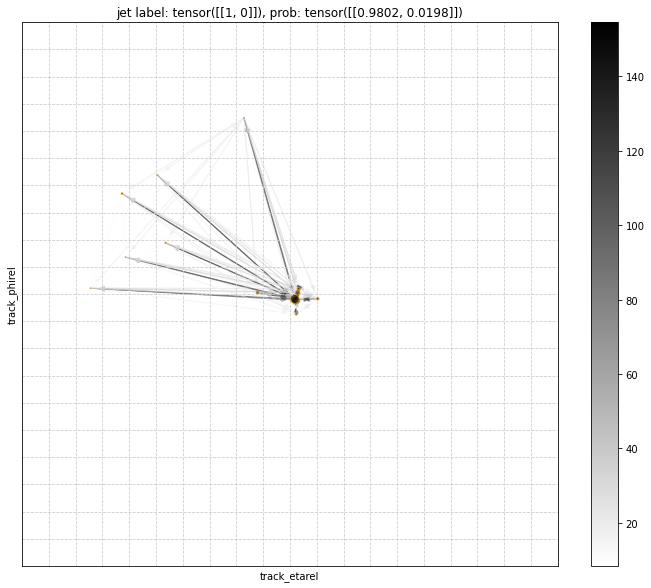

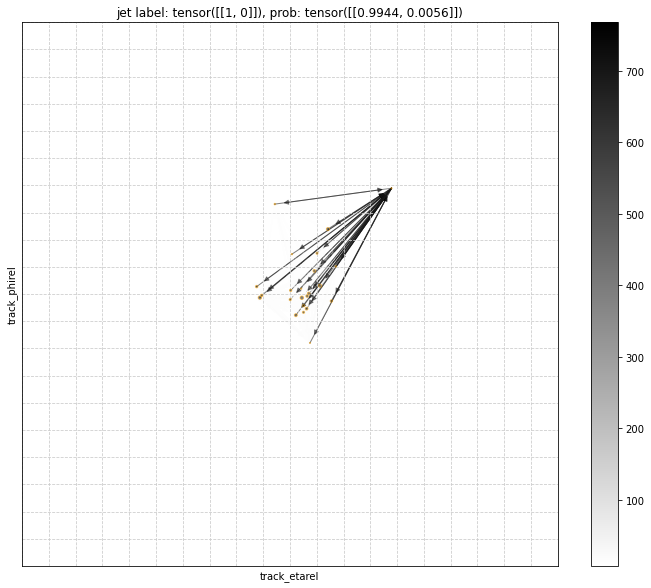

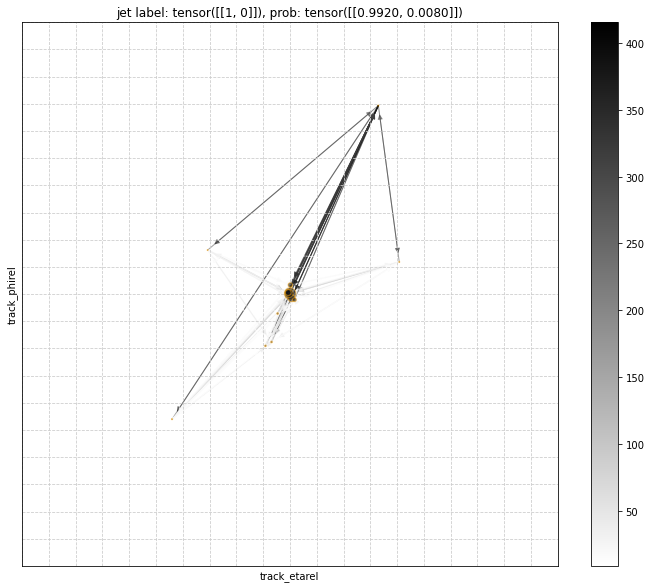

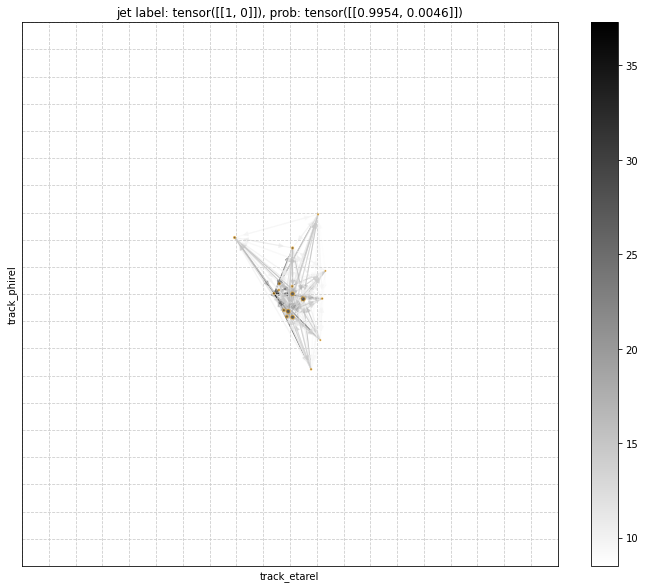

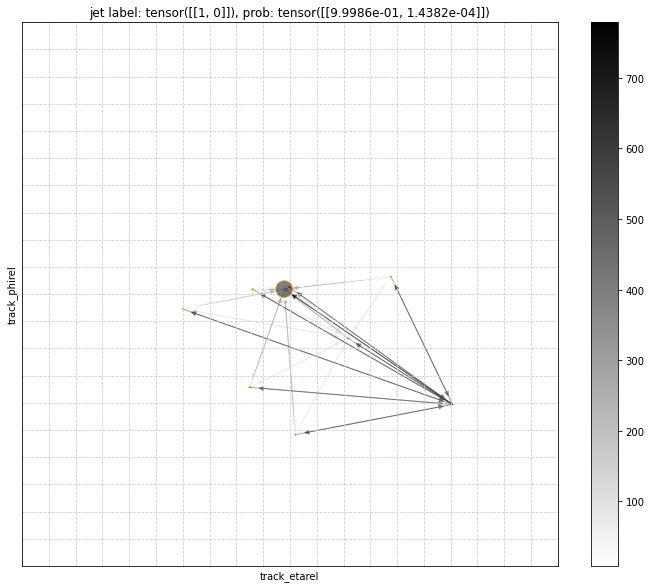

In [15]:
cnt=0
for g in batch:
    if cnt>=30: break
        
    if g.y[0,0]>0:
        _=plot_graph(g)
        cnt+=1
    else:
        continue

### histogram of edge weights

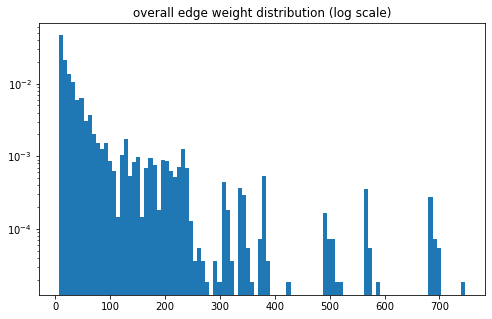

In [16]:
fig, ax =plt.subplots(figsize=(8,5))

plt.hist(np.hstack(weights),density=True,bins=100,log=True)
plt.title("overall edge weight distribution (log scale)")
plt.show()

Edge weight distribution normalized independently. QCD jet edge weights in blue and Hbb jet edge weights in orange.

ValueError: need at least one array to concatenate

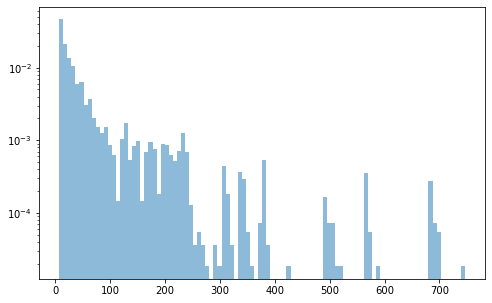

In [17]:
fig, ax =plt.subplots(figsize=(8,5))

plt.hist(np.hstack([w for i,w in enumerate(weights) if batch_small[i].y[0,0]>0]),density=True,bins=100,log=True,alpha=0.5)
plt.hist(np.hstack([w for i,w in enumerate(weights) if batch_small[i].y[0,1]>0]),density=True,bins=100,log=True,alpha=0.5)

plt.show()

<hr>

# WIP

### heatmap of weighted in-degree and out-degree

In [ ]:
# todo

### threshold edges based on overall frequency

In [13]:
import pandas as pd

In [14]:
wgts=pd.DataFrame({
    "wgts":weights,
    "label":[batch_small[i].y[0,1].cpu().numpy() for i in range(len(batch_small))]
})

wgts=wgts.reset_index(drop=False)
wgts.head()

,index,wgts,label
0,0,"[308.8824, 310.93564, 309.43137, 315.02774, 33...",0
1,1,"[90.4941, 78.642136, 88.31831, 80.709114, 80.6...",0
2,2,"[31.224459, 21.810265, 18.205162, 79.09169, 31...",0
3,3,"[52.55214, 18.630789, 15.212272, 13.064697, 56...",0
4,4,"[79.69988, 106.31762, 80.65729, 88.84491, 82.9...",0


In [15]:
wgts=wgts.explode("wgts").reset_index(drop=True)
wgts.head()

,index,wgts,label
0,0,308.882,0
1,0,310.936,0
2,0,309.431,0
3,0,315.028,0
4,0,332.581,0


In [16]:
out=pd.cut(wgts.wgts,bins=100)
wgts["bin"]=out
wgts["freq"]=wgts["bin"].apply(lambda x: wgts.bin.value_counts(normalize=True)[x])
wgts.head()

,index,wgts,label,bin,freq
0,0,308.882,0,"(302.989, 310.381]",0.003281
1,0,310.936,0,"(310.381, 317.774]",0.001367
2,0,309.431,0,"(302.989, 310.381]",0.003281
3,0,315.028,0,"(310.381, 317.774]",0.001367
4,0,332.581,0,"(332.558, 339.95]",0.002734


In [17]:
out_hbb=pd.cut(wgts.loc[wgts.label==1,"wgts"],bins=100)#.value_counts(normalize=True,sort=False)
out_qcd=pd.cut(wgts.loc[wgts.label==0,"wgts"],bins=100)#.value_counts(normalize=True,sort=False)

freq_hbb=wgts.loc[wgts.label==1,"wgts"].apply(lambda x: out_hbb.value_counts(normalize=True)[x])


ValueError: Cannot cut empty array

In [ ]:
plt.scatter(wgts.loc[wgts.label==1,"wgts"],(freq_hbb/wgts.loc[wgts.label==1,"freq"]))

In [ ]:
importance=(freq_hbb/wgts.loc[wgts.label==1,"freq"])
importance.std(),importance.mean()

In [18]:
mask=importance.apply(lambda x: (x>(importance.mean()+importance.std())) or (x<importance.mean()-importance.std()))
mask

NameError: name 'importance' is not defined

In [19]:
wgts.loc[wgts.label==1,"wgts"][mask].hist()

NameError: name 'mask' is not defined

<hr>

In [32]:
import plotly.graph_objects as go
import numpy as np
np.random.seed(1)

N = 70

fig = go.Figure(data=[
                go.Mesh3d(
                    x=(70*np.random.randn(N)), 
                    y=(55*np.random.randn(N)),
                    z=(40*np.random.randn(N)),
                    opacity=0.5,
                    color='rgba(244,22,100,0.6)'
                )])

# fig.update_layout(
#     scene = dict(
#         xaxis = dict(nticks=4, range=[-100,100],),
#                      yaxis = dict(nticks=4, range=[-50,100],),
#                      zaxis = dict(nticks=4, range=[-100,100],),),
#     width=700,
#     margin=dict(r=20, l=10, b=10, t=10))

fig.show()

TypeError: forward() missing 1 required positional argument: 'input'

In [26]:
def network_plot_3D(G, angle,label,u, save=False):

    # Get node positions
    pos = nx.get_node_attributes(G, 'pos')
    
    # Get number of nodes
    n = G.number_of_nodes()

    # Get the maximum number of edges adjacent to a single node
#     edge_max = max([G.degree(i) for i in range(n)])

    # Define color range proportional to number of edges adjacent to a single node
#     colors = [plt.cm.plasma(G.degree(i)/edge_max) for i in range(n)] 

    # 3D network plot
    with plt.style.context(('ggplot')):
        
        fig = plt.figure(figsize=(10,7))
        ax = Axes3D(fig)
        
        # Loop on the pos dictionary to extract the x,y,z coordinates of each node
        for key, value in pos.items():
            xi = value[0]
            yi = value[1]
            zi = value[2]
            
            # Scatter plot
            ax.scatter(xi, yi, zi, c='k',s=25, edgecolors='orange', alpha=0.5)
        
        # Loop on the list of edges to get the x,y,z, coordinates of the connected nodes
        # Those two points are the extrema of the line to be plotted
        weight=list(nx.get_edge_attributes(G, 'weight').values())
        sm = plt.cm.ScalarMappable(cmap=plt.cm.Blues, norm=plt.Normalize(vmin=min(weight), vmax=max(weight)))
        for i,j in enumerate(G.edges()):

            x = np.array((pos[j[0]][0], pos[j[1]][0]))
            y = np.array((pos[j[0]][1], pos[j[1]][1]))
            z = np.array((pos[j[0]][2], pos[j[1]][2]))
        
        # Plot the connecting lines
            
            ax.plot(x, y, z, c=sm.to_rgba(weight[i]), alpha=0.2)
    
    # Set the initial view
    ax.view_init(30, angle)

    # Hide the axes
#     ax.set_axis_off()
    plt.xlabel("track_etarel")
    plt.ylabel("track_phirel")
    plt.title(f"jet label: {label}, prob: {activation(u)}")
    plt.show()
    
    return

# 3D plot with momentum as z-axis, but with bokeh

In [27]:
%matplotlib notebook

In [37]:
u, edge_attr=model(g.x, g.edge_index, g.batch)

In [39]:
edge_attr

tensor([[-26.4678, -20.5479,  14.6241,  ..., -59.1990,  26.9459, -12.7217],
        [-26.4312, -20.9764,  14.8291,  ..., -60.3428,  26.9709, -11.9017],
        [-26.9232, -20.8707,  14.7369,  ..., -59.8769,  27.0491, -12.1586],
        ...,
        [ -2.6268,  -4.8962,  -2.1089,  ...,  -1.3848,  -6.6102,   1.1955],
        [  1.2964,  -5.4185,  -1.7152,  ...,   1.4469,  -6.3055,   0.0695],
        [ -2.4631,  -5.4031,  -1.1014,  ...,  -1.5842,  -6.4534,   1.7161]],
       device='cuda:0', grad_fn=<AddmmBackward>)

In [53]:
g = batch_small[0]
g.weight

array([308.8824   , 310.93564  , 309.43137  , 315.02774  , 332.58093  ,
       309.85226  , 312.1412   , 312.06955  , 310.51614  , 319.05222  ,
       312.8722   , 313.73782  , 305.26633  , 316.57965  , 307.23312  ,
       320.8714   , 230.84964  ,  13.500277 ,  10.582078 ,  22.449802 ,
        68.12068  ,  10.943445 ,  14.667045 ,  14.651951 ,  11.477196 ,
        30.870953 ,  19.939734 ,  17.900497 ,  18.938625 ,  34.21546  ,
        18.013885 ,  48.717804 , 229.98361  ,  13.719887 ,  12.032383 ,
        22.9377   ,  68.54749  ,  12.106934 ,  15.488476 ,  15.511174 ,
        12.326073 ,  31.14092  ,  19.312294 ,  18.051258 ,  20.90865  ,
        32.212868 ,  19.947308 ,  46.48866  , 231.06075  ,  10.416342 ,
        12.786726 ,  21.662409 ,  67.33577  ,  10.044267 ,  13.92852  ,
        13.9918165,  10.344719 ,  30.063133 ,  17.116884 ,  16.274353 ,
        19.540367 ,  29.869204 ,  18.872568 ,  44.76886  , 228.54005  ,
        21.415619 ,  21.20207  ,  19.450815 ,  72.46231  ,  19.4

In [64]:
import plotly.express as px
df = px.data.iris()

fig = px.scatter_3d(g.pos, x=0, y=1, z=2)
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))

fig.show()

In [96]:
model.eval()
with torch.no_grad():
    u, edge_attr=model(g.x, g.edge_index, torch.tensor(np.zeros(g.x.shape[0]).astype("int64")))

RuntimeError: All input tensors must be on the same device. Received cpu and cuda:0

In [ ]:
import jgraph as ig
import json
try:
    # For Python 3.0 and later
    from urllib.request import urlopen
except ImportError:
    # Fall back to Python 2's urllib2
    from urllib2 import urlopen
    
data = []

f = urlopen("https://raw.githubusercontent.com/plotly/datasets/master/miserables.json")
data = json.loads(f.read())

data['nodes']
N=len(data['nodes'])
L=len(data['links'])
Edges=[(data['links'][k]['source'], data['links'][k]['target']) for k in range(L)]

G=ig.draw(Edges, directed=False)


In [106]:
ig?

In [97]:
g = batch_small[0]
N = g.x.shape[0]


In [99]:
g.pos

array([[ 5.05812526e-01,  5.14127374e-01,  1.04589844e+00],
       [ 1.08633339e-02, -1.53941382e-02,  2.52929688e+00],
       [-1.05606616e-02,  1.95707157e-02,  9.70312500e+00],
       [ 2.47797668e-02,  3.81224714e-02,  2.18359375e+00],
       [-1.25748813e-02,  1.57625284e-02,  2.45937500e+01],
       [-1.58822536e-03,  1.27355913e-02,  9.24375000e+01],
       [ 5.46268523e-02, -8.36623162e-02,  1.19824219e+00],
       [ 6.65290654e-02,  6.55681938e-02,  1.01171875e+01],
       [-2.88717747e-02,  5.70503669e-03,  9.85156250e+00],
       [ 4.74317402e-01,  2.09514260e-01,  2.10351562e+00],
       [-7.81399012e-03,  1.09774731e-02,  3.59062500e+01],
       [-3.34495604e-02,  4.62927343e-03,  1.69218750e+01],
       [-1.05606616e-02,  3.45861004e-03,  1.38281250e+01],
       [-5.16496539e-01, -5.83467424e-01,  1.47753906e+00],
       [ 4.30908501e-02, -1.12465471e-01,  5.19531250e+00],
       [-8.36219788e-02,  1.76410511e-01,  5.17187500e+00],
       [ 5.04153073e-02, -5.09634376e-01

<IPython.core.display.Javascript object>


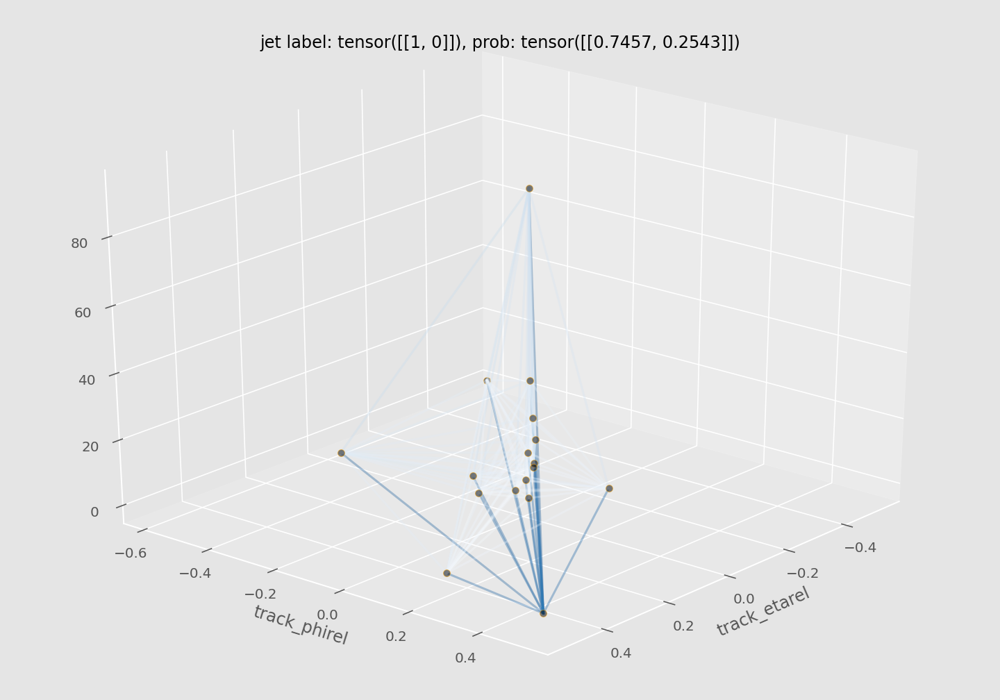

In [35]:
activation=nn.Softmax(1)

g = batch_small[0]
g.batch=torch.tensor(np.zeros(g.x.shape[0]).astype("int64"))
g.to(device)

model.eval()
with torch.no_grad():
    u, edge_attr=model(g.x, g.edge_index, g.batch)

edge_attr=edge_attr.detach().cpu()
#     weight=edge_attr.mean(1)
weight=np.linalg.norm(edge_attr,ord=2,axis=1)

g.weight=weight
pos=np.array(list(zip(g.x[:,eta_idx].cpu().numpy(),g.x[:,phi_idx].cpu().numpy(),g.x[:,0].cpu().numpy())))
g.pos=pos

G = to_networkx(g, edge_attrs=['weight'],node_attrs=["pos"])
network_plot_3D(G,45,g.y.detach().cpu(),u.detach().cpu())

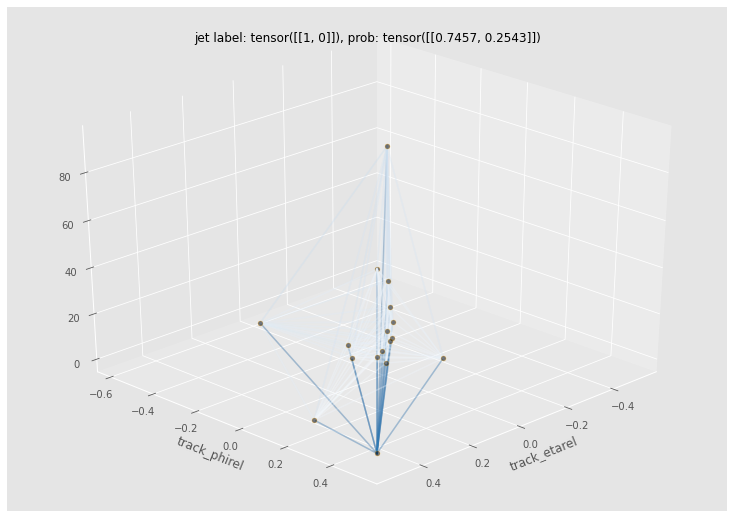

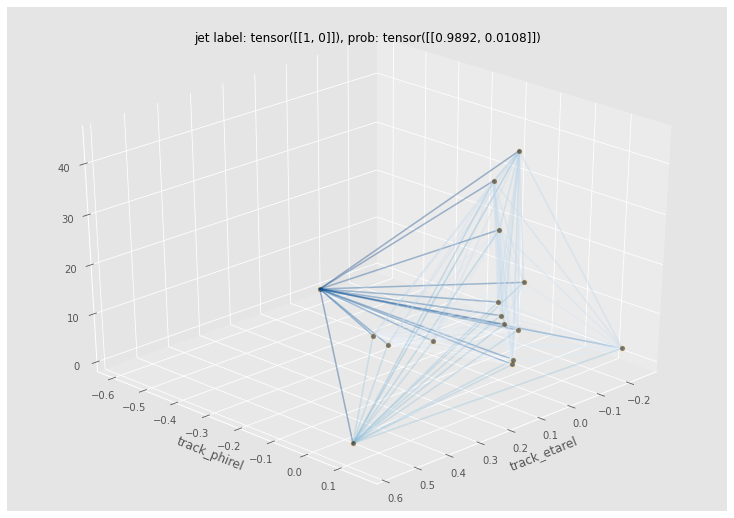

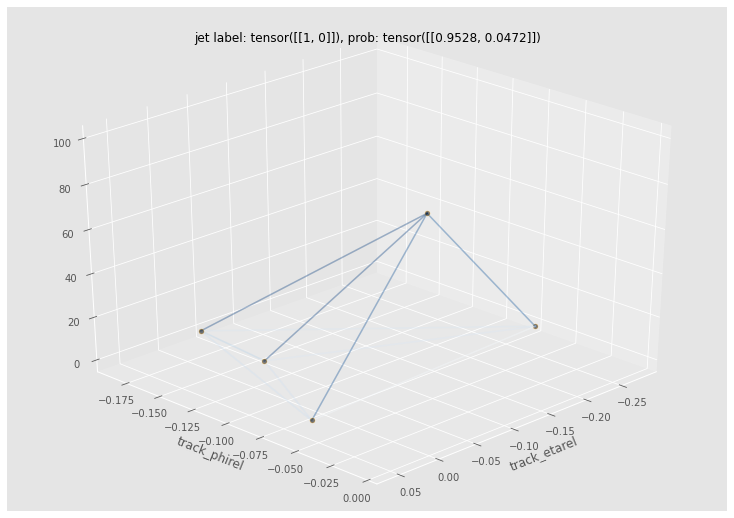

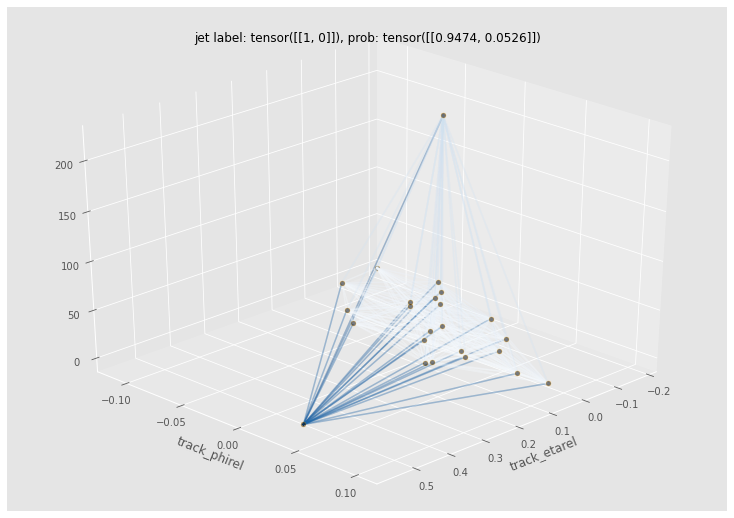

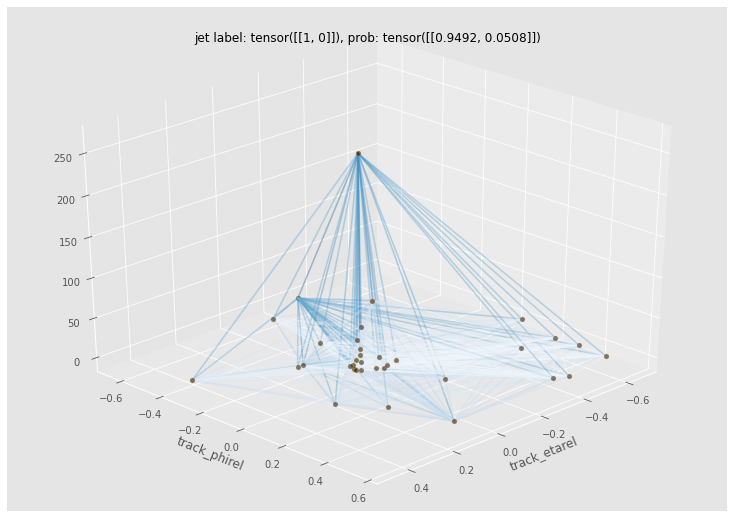

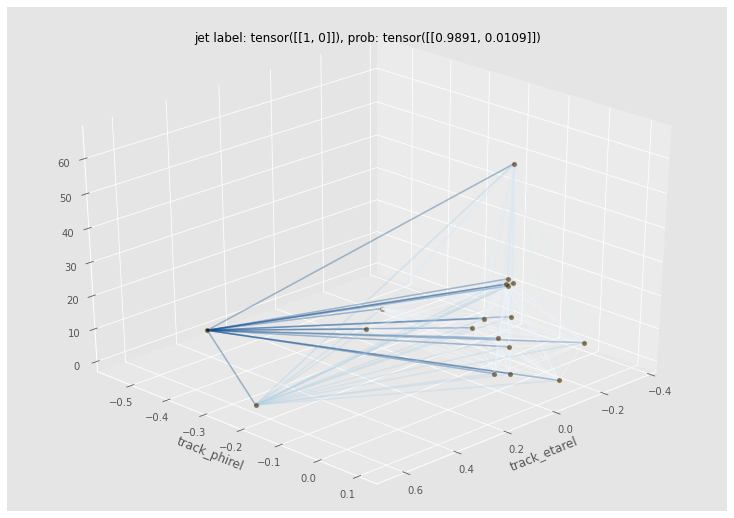

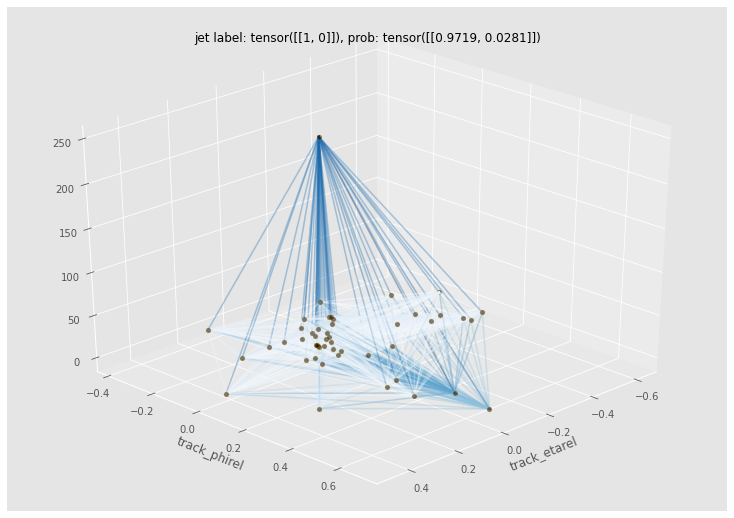

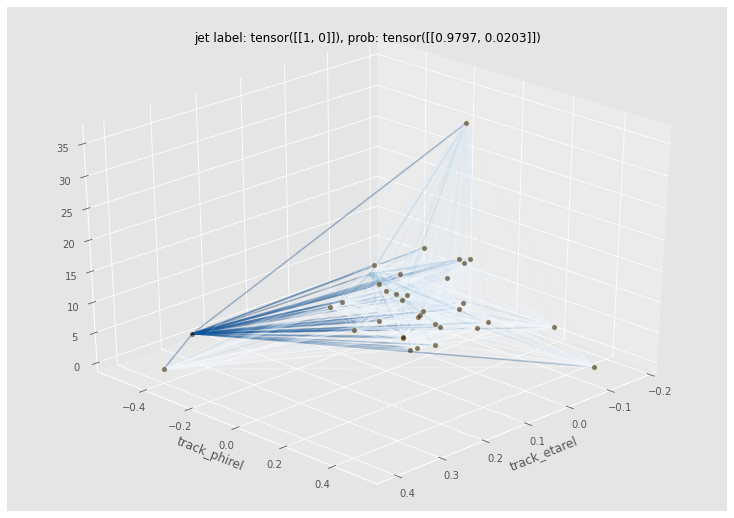

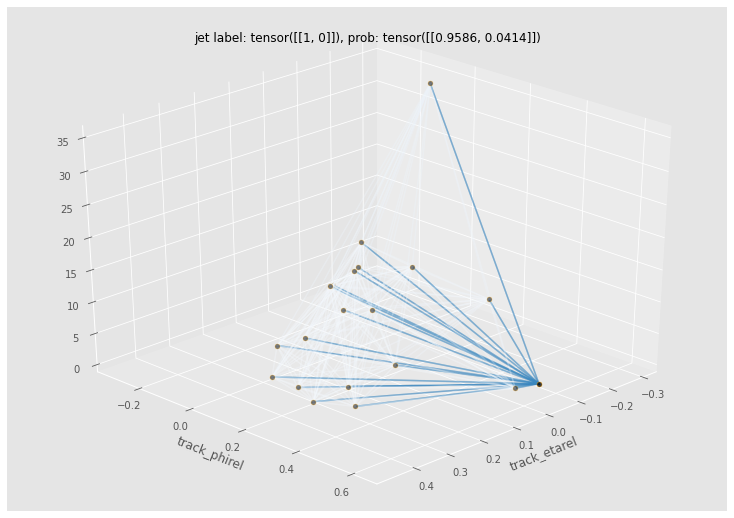

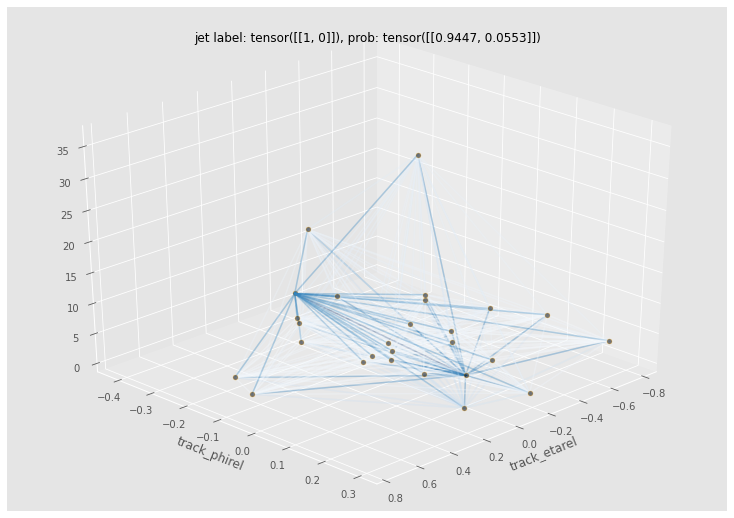

In [26]:
activation=nn.Softmax(1)

for g in batch_small:
    g.batch=torch.tensor(np.zeros(g.x.shape[0]).astype("int64"))
    g.to(device)

    model.eval()
    with torch.no_grad():
        u,edge_attr=model(g.x, g.edge_index, g.batch)

    edge_attr=edge_attr.detach().cpu()
    #     weight=edge_attr.mean(1)
    weight=np.linalg.norm(edge_attr,ord=2,axis=1)

    g.weight=weight
    pos=np.array(list(zip(g.x[:,eta_idx].cpu().numpy(),g.x[:,phi_idx].cpu().numpy(),g.x[:,0].cpu().numpy())))
    g.pos=pos

    G = to_networkx(g, edge_attrs=['weight'],node_attrs=["pos"])
    network_plot_3D(G,45,g.y.detach().cpu(),u.detach().cpu())

 ## first 30 higgs jet

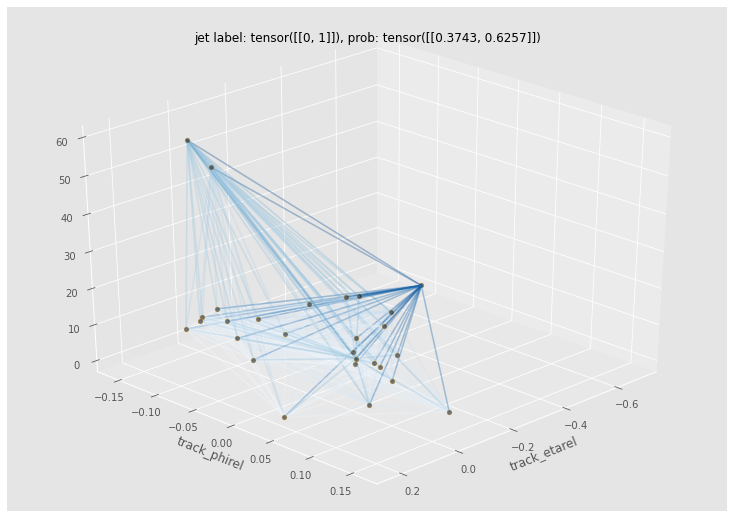

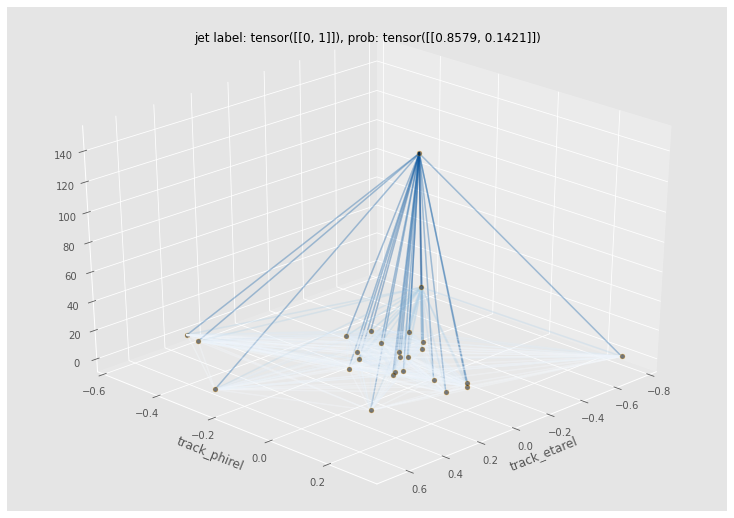

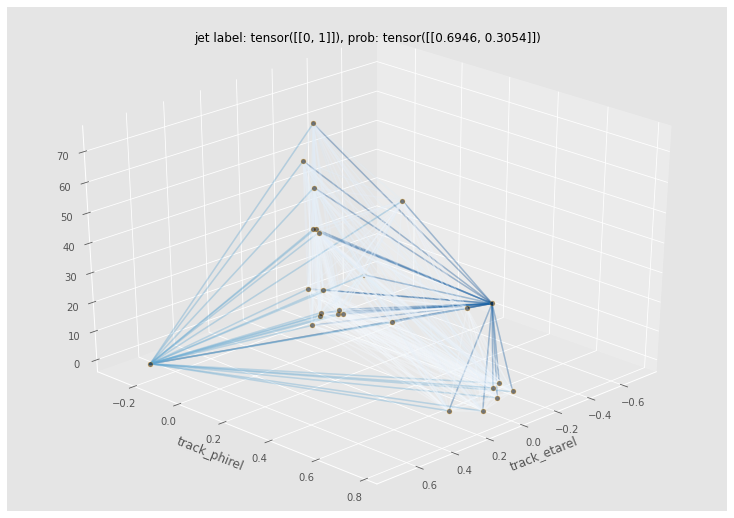

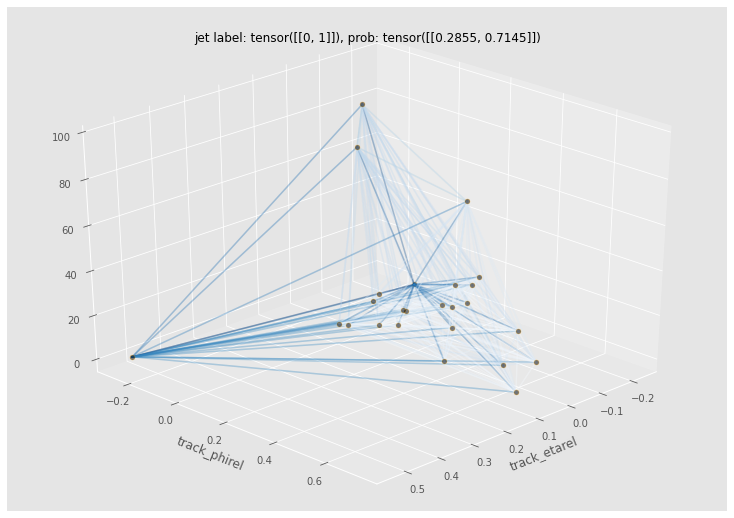

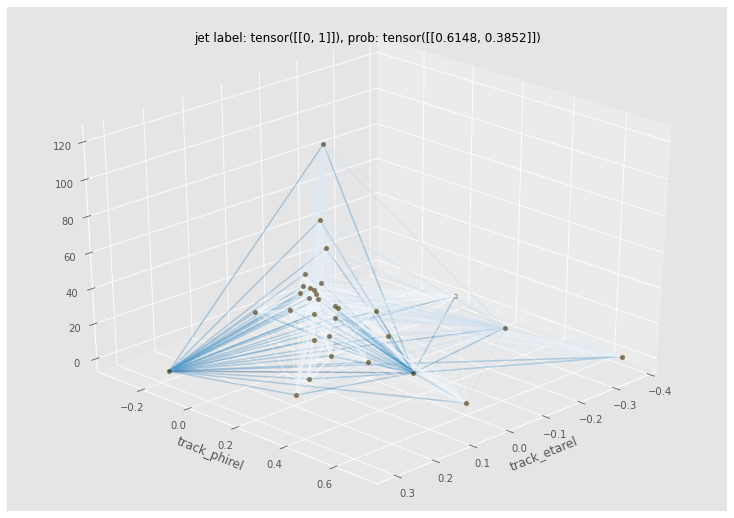

...

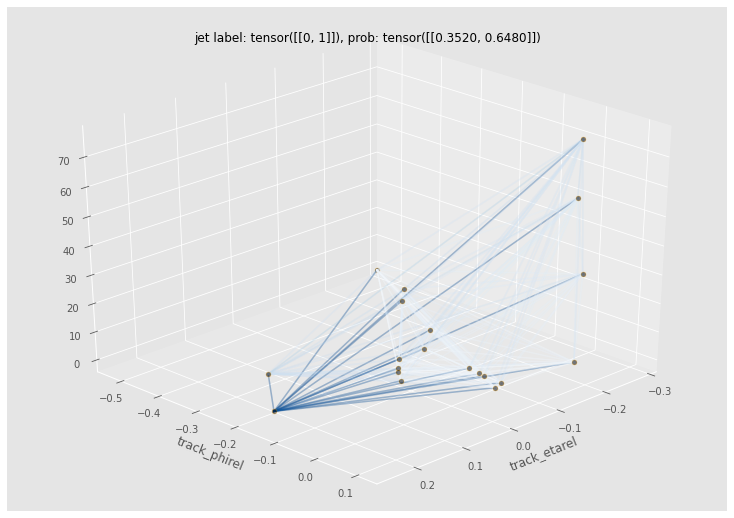

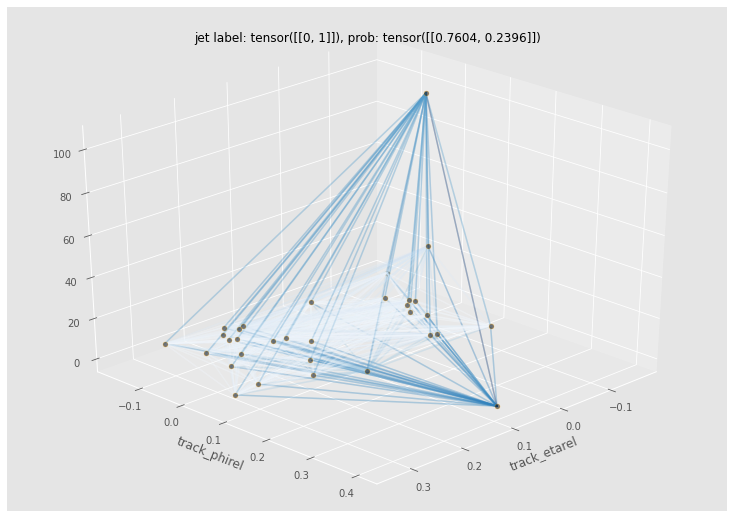

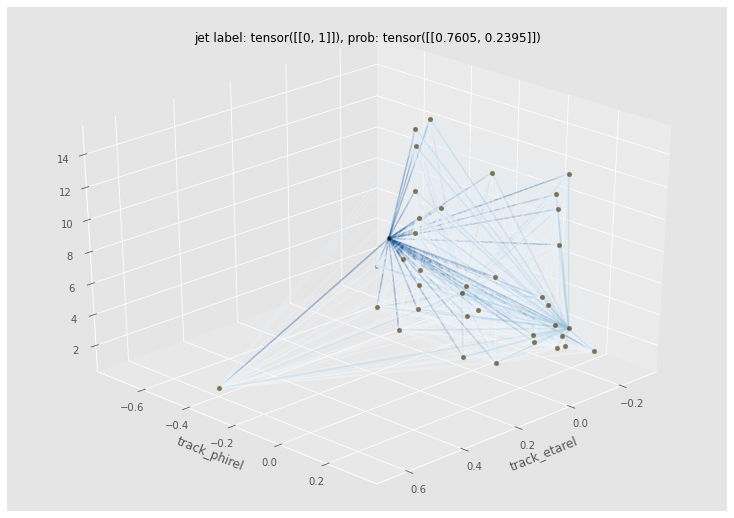

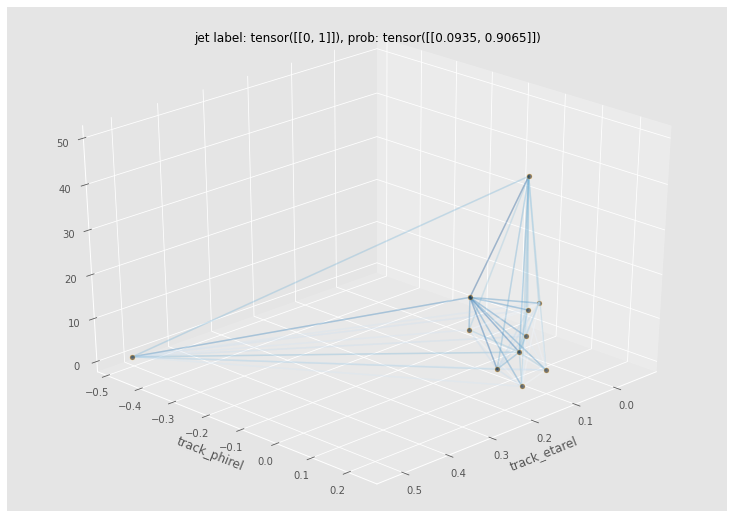

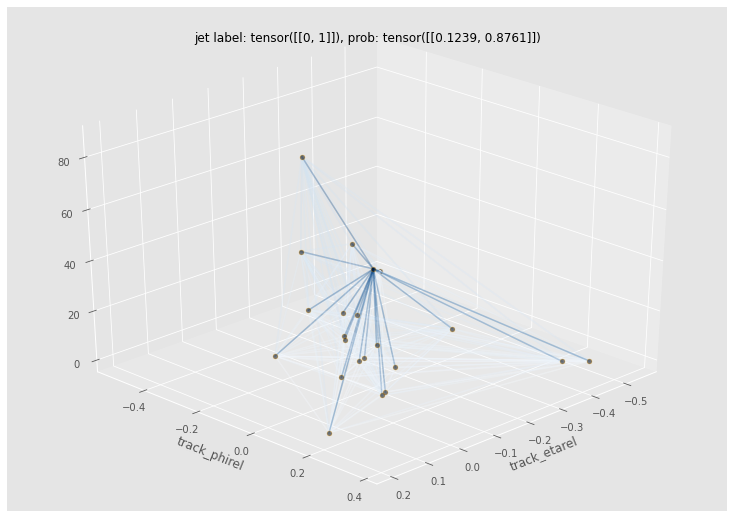

In [27]:
cnt=0
for g in batch:
    if cnt>=30: break
        
    if g.y[0,1]>0:
        g.batch=torch.tensor(np.zeros(g.x.shape[0]).astype("int64"))
        g.to(device)

        model.eval()
        with torch.no_grad():
            u,edge_attr=model(g.x, g.edge_index, g.batch)

        edge_attr=edge_attr.detach().cpu()
        #     weight=edge_attr.mean(1)
        weight=np.linalg.norm(edge_attr,ord=2,axis=1)

        g.weight=weight
        pos=np.array(list(zip(g.x[:,eta_idx].cpu().numpy(),g.x[:,phi_idx].cpu().numpy(),g.x[:,0].cpu().numpy())))
        g.pos=pos

        G = to_networkx(g, edge_attrs=['weight'],node_attrs=["pos"])
        network_plot_3D(G,45,g.y.detach().cpu(),u.detach().cpu())
        cnt+=1
    else:
        continue